In [94]:
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np

In [95]:
from pathlib import Path

IMAGES_PATH = Path() / "images" / "DailyResourceConsumption"
IMAGES_PATH.mkdir(parents=True, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = IMAGES_PATH / f"{fig_id}.{fig_extension}"
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

In [96]:
from pathlib import Path

orgin_path = "D:\\Iman\\AGHC\\CherryTomato\Data\\"
filenames = ['AICU', 'Automatoes',
             'Digilog', 'IUACAAS', 
             'Reference', 'TheAutomators'
             ]
daily_Avg=dict()
Daily_Resource_Consumption=dict()
greenhouse_climate=dict()
for filename in filenames:
    path=Path(orgin_path+filename+'\\Resources.csv')
    Daily_Resource_Consumption[filename] = pd.read_csv(path,parse_dates=["%Time "],low_memory=False).set_index('%Time ').astype(float)
    #print(Daily_Resource_Consumption[filename].index.shape)
    Daily_Resource_Consumption[filename]['%Time_t']=Daily_Resource_Consumption[filename].index.astype(str)+"_"+filename
    Daily_Resource_Consumption[filename]=Daily_Resource_Consumption[filename].set_index('%Time_t')
    path=Path(orgin_path+filename+'\\GreenhouseClimate.csv')
    greenhouse_climate[filename]=pd.read_csv(path,parse_dates=["%time"],low_memory=False).set_index('%time').astype(float)
    
    #greenhouse_climate[filename].drop(columns=[  'AssimLight', 'BlackScr', 'CO2air', 'EC_drain_PC', 'EnScr', 'HumDef',
    #    'Rhair','Tot_PAR', 'Tot_PAR_Lamps','VentLee', 'Ventwind', 'co2_dos'],inplace=True)
    sp_vip_paired_attributtes=[ [('assim_sp','assim_vip'),('assim_vip','assim_sp')],
                            [('co2_sp','co2_vip'),('co2_vip','co2_sp')],
                            [('dx_sp','dx_vip'),('dx_vip','dx_sp')],
                            [('int_blue_sp','int_blue_vip'),('int_blue_vip','int_blue_sp')],
                            [('int_farred_sp','int_farred_vip'),('int_farred_vip','int_farred_sp')],
                            [('int_red_sp','int_red_vip'),('int_red_vip','int_red_sp')], 
                            [('int_white_sp','int_white_vip'),('int_white_vip','int_white_sp')],
                            [('scr_blck_sp','scr_blck_vip'),('scr_blck_vip','scr_blck_sp')],
                            [('scr_enrg_sp','scr_enrg_vip'),('scr_enrg_vip','scr_enrg_sp')],
                            [('t_grow_min_sp','t_grow_min_vip'),('t_grow_min_vip','t_grow_min_sp')],
                            [('t_heat_sp','t_heat_vip'),('t_heat_vip','t_heat_sp')],
                            [('t_rail_min_sp','t_rail_min_vip'),('t_rail_min_vip','t_rail_min_sp')],
                            [('t_vent_sp','t_ventlee_vip'),('t_ventlee_vip','t_vent_sp')],
                            [('water_sup_intervals_sp_min','water_sup_intervals_vip_min'),('water_sup_intervals_vip_min','water_sup_intervals_sp_min')],
                            [('window_pos_lee_sp','window_pos_lee_vip'),('window_pos_lee_vip','window_pos_lee_sp')],
                            ]
    norm_mean_difference=[]
    for sp_vip_paired_attributte in sp_vip_paired_attributtes: 
        for (sp, vip) in sp_vip_paired_attributte:
            x=greenhouse_climate[filename].iloc[(np.where(greenhouse_climate[filename][sp].isnull()))][vip]
            #print(teams_ghc[sp])
            difference=(greenhouse_climate[filename][sp]-greenhouse_climate[filename][vip]).mean()
            mean_difference=difference/(greenhouse_climate[filename][sp].mean())
            norm_mean_difference.append([sp,vip,mean_difference])

            #print(f'{sp},{vip} difference={norm_mean_difference}')
            #print(x.index)
            for i in x.index:
                #print(i)
                greenhouse_climate[filename].loc[i,sp]= greenhouse_climate[filename].loc[i,vip]#.iloc[i][vip]
                #print(i,teams_ghc.loc[i,sp]) 
            #plt.figure()
            #correlation = greenhouse_climate[filename].corr()[vip][sp]
            #corr1=greenhouse_climate[filename].corr()[vip].sort_values(ascending=False)
            #corr1.plot(kind='bar',title=f'{vip} SP-VIP Correlation',figsize=(18, 6),fontsize=12)
            ##plt.show
            #save_fig(f'{vip}SP-VIP Correlation')
            #print(f"correlation between {vip} and {sp}=",correlation)
            #plt.show
    norm_mean_difference     



    #fill missing values
    for gh_attribute in greenhouse_climate[filename].columns:
        x=greenhouse_climate[filename].iloc[(np.where(greenhouse_climate[filename][gh_attribute].isnull()))][gh_attribute]
        for i in reversed(x.index):
            if i.day+(1)< greenhouse_climate[filename].index[-1].day:
                #print(i+(12*24))
                d=i
                #print(d)

                d = d.replace(day=d.day+1)

                #print(d)
                greenhouse_climate[filename].loc[i,gh_attribute]= greenhouse_climate[filename].loc[d,gh_attribute]
                #print(i+(12*24),teams_ghc.loc[i,gh_attribute])
    for gh_attribute in greenhouse_climate[filename].columns:
        x=greenhouse_climate[filename].iloc[(np.where(greenhouse_climate[filename][gh_attribute].isnull()))][gh_attribute]
        for i in x.index:
            if i.day-(1)>= 0:
                #print(i+(12*24))
                d=i
                #print(d)
                d = d.replace(day=d.day-1)
                #print(d)
                greenhouse_climate[filename].loc[i,gh_attribute]= greenhouse_climate[filename].loc[d,gh_attribute]
                #print(i+(12*24),teams_ghc.loc[i,gh_attribute])

    #print(greenhouse_climate[filename].groupby(greenhouse_climate[filename].index.date).mean())
    
    daily_Avg[filename]=greenhouse_climate[filename].groupby(greenhouse_climate[filename].index.date).mean()
    #daily_Avg[filename]['water_sup_intervals_vip_min']=greenhouse_climate[filename].groupby(greenhouse_climate[filename].index.date).sum()['water_sup_intervals_vip_min']
    daily_Avg[filename]['%time_t']=daily_Avg[filename].index.astype(str)+"_"+filename
    daily_Avg[filename]=daily_Avg[filename].set_index('%time_t')
    #print(daily_Avg[filename].index[-1])
    daily_Avg[filename].drop(daily_Avg[filename].index[-1],axis=0,inplace=True)
    greenhouse_climate[filename]['%time_t']=greenhouse_climate[filename].index.astype(str)+"_"+filename
    greenhouse_climate[filename]=greenhouse_climate[filename].set_index('%time_t')



C:\Users\user\AppData\Local\Temp\ipykernel_23304\73333864.py:44: RuntimeWarning:

invalid value encountered in double_scalars

C:\Users\user\AppData\Local\Temp\ipykernel_23304\73333864.py:44: RuntimeWarning:

invalid value encountered in double_scalars



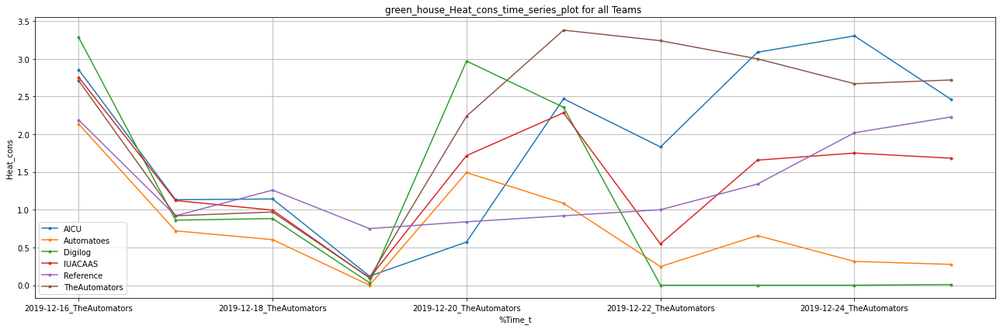

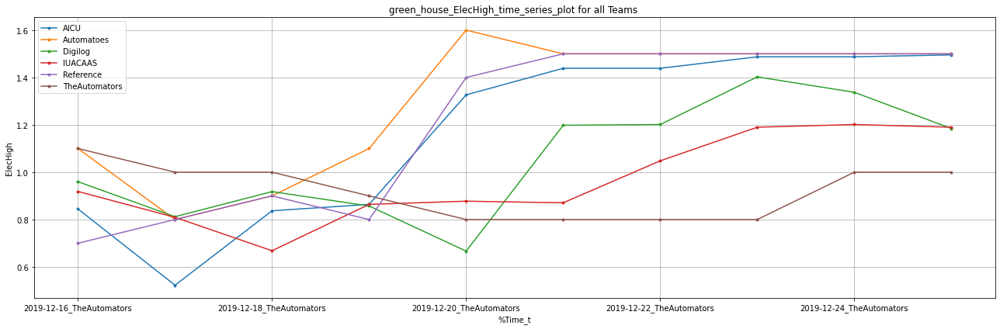

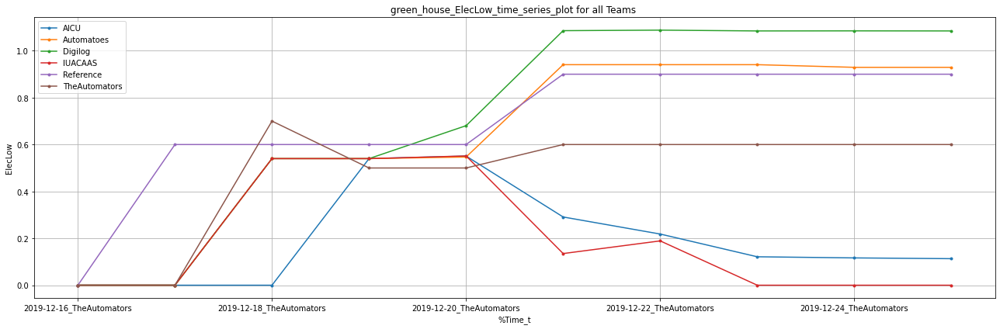

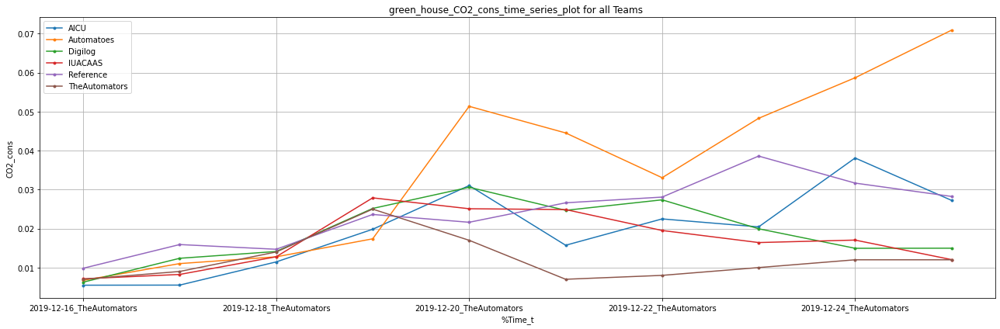

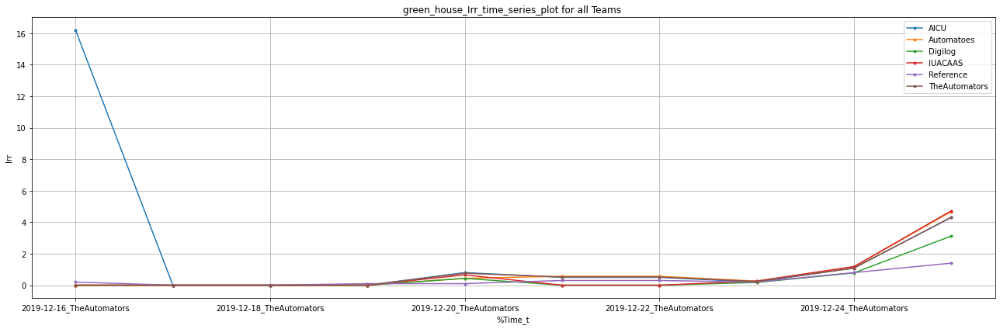

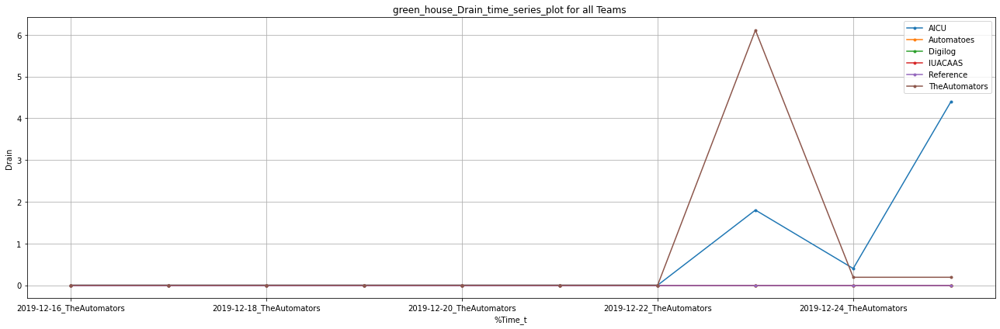

In [97]:
import matplotlib.pyplot as plt
for resource in Daily_Resource_Consumption[filename].columns:
    for i in range(len(filenames)):
        Daily_Resource_Consumption[filenames[i]]["2019-12-16 00:00:00" : "2019-12-26 00:00:00"][resource].plot(ylabel=resource,grid=True, marker=".", figsize=(18, 6),legend=True,label=f'{filenames[i]}')
    plt.title(f'green_house_{resource}_time_series_plot for all Teams ')
    plt.legend()
    save_fig(f'green_house_{resource}_time_series_plot ')

    plt.show()

In [98]:

teams_drc=pd.concat([Daily_Resource_Consumption[filenames[0]],Daily_Resource_Consumption[filenames[1]],
                    Daily_Resource_Consumption[filenames[2]],Daily_Resource_Consumption[filenames[3]],
                    Daily_Resource_Consumption[filenames[4]],Daily_Resource_Consumption[filenames[5]]], axis=0)

teams_ghc=pd.concat([greenhouse_climate[filenames[0]],greenhouse_climate[filenames[1]],
                     greenhouse_climate[filenames[2]],greenhouse_climate[filenames[3]],
                     greenhouse_climate[filenames[4]],greenhouse_climate[filenames[5]]], axis=0)

teams_da=pd.concat([ daily_Avg[filenames[0]],daily_Avg[filenames[1]],
                     daily_Avg[filenames[2]],daily_Avg[filenames[3]],
                     daily_Avg[filenames[4]],daily_Avg[filenames[5]]], axis=0)





In [99]:
teams_ghc.astype(float).isnull().sum().sum()

0

In [100]:
teams_ghc.index

Index(['2019-12-16 00:00:00_AICU', '2019-12-16 00:05:00_AICU',
       '2019-12-16 00:10:00_AICU', '2019-12-16 00:15:00_AICU',
       '2019-12-16 00:20:00_AICU', '2019-12-16 00:25:00_AICU',
       '2019-12-16 00:30:00_AICU', '2019-12-16 00:35:00_AICU',
       '2019-12-16 00:40:00_AICU', '2019-12-16 00:45:00_AICU',
       ...
       '2020-05-29 23:15:00_TheAutomators',
       '2020-05-29 23:20:00_TheAutomators',
       '2020-05-29 23:25:00_TheAutomators',
       '2020-05-29 23:30:00_TheAutomators',
       '2020-05-29 23:35:00_TheAutomators',
       '2020-05-29 23:40:00_TheAutomators',
       '2020-05-29 23:45:00_TheAutomators',
       '2020-05-29 23:50:00_TheAutomators',
       '2020-05-29 23:55:00_TheAutomators',
       '2020-05-30 00:00:00_TheAutomators'],
      dtype='object', name='%time_t', length=286854)

array([[<AxesSubplot:title={'center':'AssimLight'}>,
        <AxesSubplot:title={'center':'BlackScr'}>,
        <AxesSubplot:title={'center':'CO2air'}>,
        <AxesSubplot:title={'center':'Cum_irr'}>,
        <AxesSubplot:title={'center':'EC_drain_PC'}>,
        <AxesSubplot:title={'center':'EnScr'}>,
        <AxesSubplot:title={'center':'HumDef'}>],
       [<AxesSubplot:title={'center':'PipeGrow'}>,
        <AxesSubplot:title={'center':'PipeLow'}>,
        <AxesSubplot:title={'center':'Rhair'}>,
        <AxesSubplot:title={'center':'Tair'}>,
        <AxesSubplot:title={'center':'Tot_PAR'}>,
        <AxesSubplot:title={'center':'Tot_PAR_Lamps'}>,
        <AxesSubplot:title={'center':'VentLee'}>],
       [<AxesSubplot:title={'center':'Ventwind'}>,
        <AxesSubplot:title={'center':'assim_sp'}>,
        <AxesSubplot:title={'center':'assim_vip'}>,
        <AxesSubplot:title={'center':'co2_dos'}>,
        <AxesSubplot:title={'center':'co2_sp'}>,
        <AxesSubplot:title={'center':'c

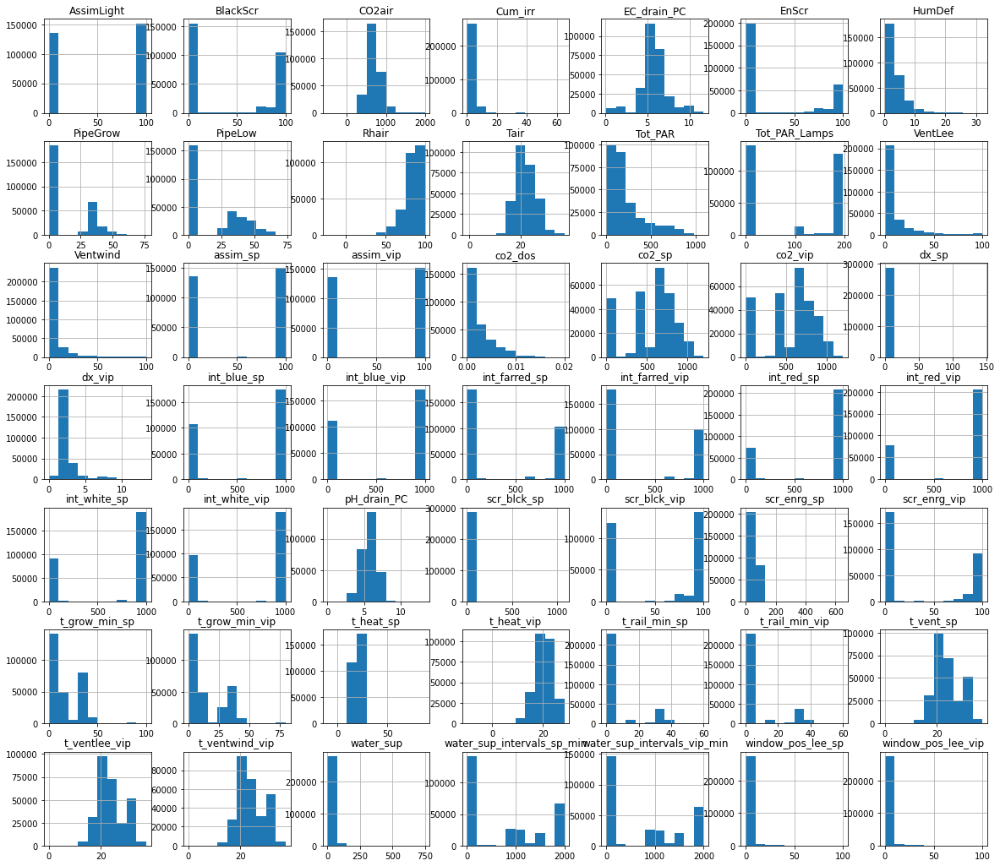

In [101]:
teams_ghc.hist(figsize=(20,18))

In [102]:
print(teams_da.shape)
print(teams_drc.shape)

(996, 49)
(996, 6)


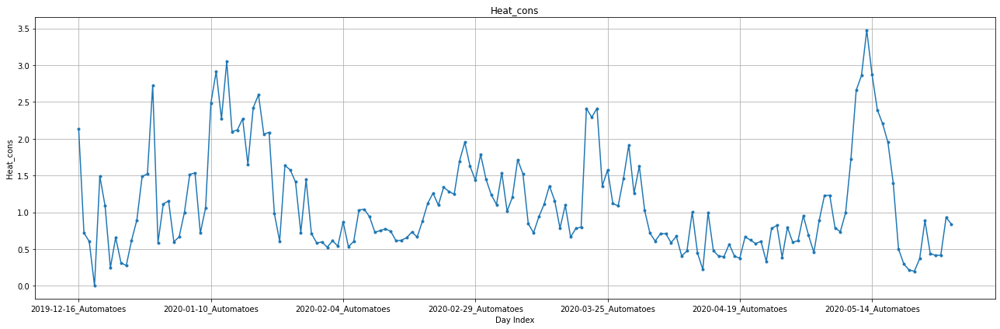

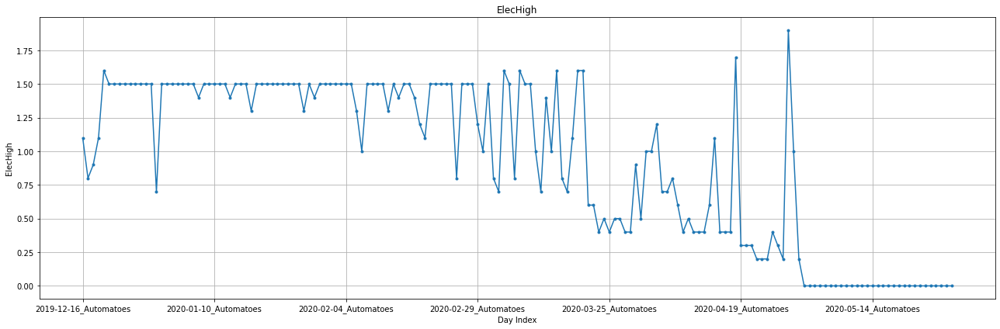

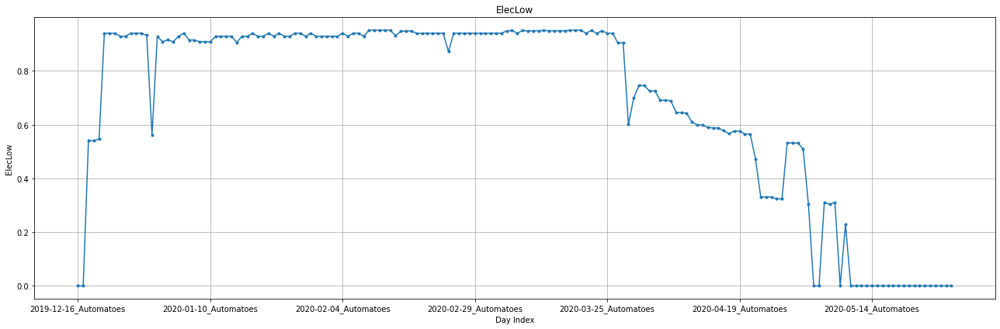

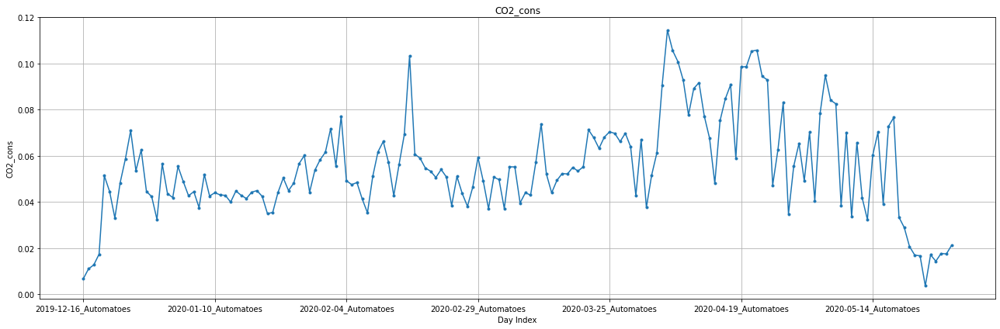

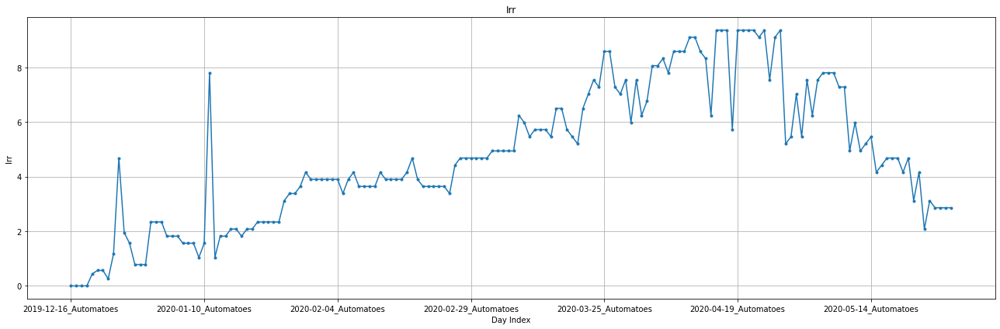

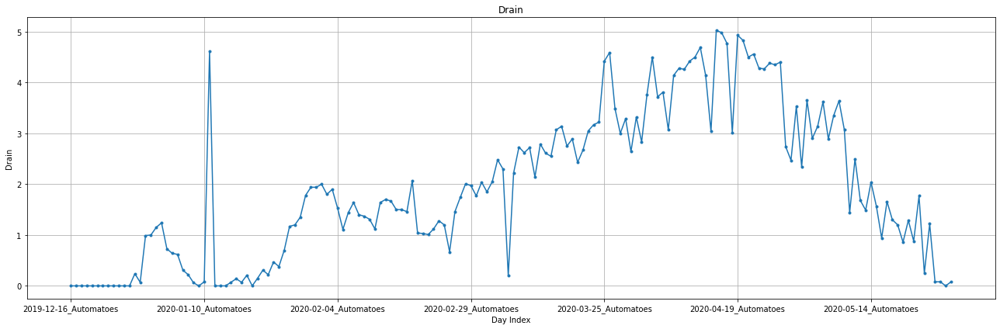

In [103]:
import matplotlib.pyplot as plt

for num_attribute in teams_drc.columns:
    
    teams_drc["2019-12-16_Automatoes" : "2020-05-29_Automatoes"][num_attribute].plot(ylabel=num_attribute,xlabel='Day Index',grid=True, marker=".", figsize=(18, 6),title=num_attribute)
    
    save_fig(f'dailyConsumptionsof_{num_attribute}_time_series_plot')

    plt.show()

In [104]:
#teams_da.drop(['assim_vip', 'co2_vip',  'dx_vip',
#       'int_blue_vip', 'int_farred_vip',
#       'int_red_vip', 'int_white_vip',
#        'scr_blck_vip', 
#       'scr_enrg_vip', 't_grow_min_vip', 
#       't_heat_vip', 't_rail_min_vip', 
#       't_ventlee_vip', 't_ventwind_vip',
#       'water_sup_intervals_vip_min',
#       'window_pos_lee_vip'],axis=1,inplace=True)
teams_da.drop(['assim_sp', 'co2_sp',  'dx_sp',
           'int_blue_sp', 'int_farred_sp','scr_blck_sp',
           'int_red_sp', 'int_white_sp','t_grow_min_sp',
           't_heat_sp', 't_rail_min_sp',
           't_vent_sp','water_sup_intervals_sp_min',
           'window_pos_lee_sp','scr_enrg_sp'],axis=1,inplace=True)

In [105]:
teams_da.shape

(996, 34)

In [106]:
teams_da.index

Index(['2019-12-16_AICU', '2019-12-17_AICU', '2019-12-18_AICU',
       '2019-12-19_AICU', '2019-12-20_AICU', '2019-12-21_AICU',
       '2019-12-22_AICU', '2019-12-23_AICU', '2019-12-24_AICU',
       '2019-12-25_AICU',
       ...
       '2020-05-20_TheAutomators', '2020-05-21_TheAutomators',
       '2020-05-22_TheAutomators', '2020-05-23_TheAutomators',
       '2020-05-24_TheAutomators', '2020-05-25_TheAutomators',
       '2020-05-26_TheAutomators', '2020-05-27_TheAutomators',
       '2020-05-28_TheAutomators', '2020-05-29_TheAutomators'],
      dtype='object', name='%time_t', length=996)

In [107]:
teams_drc.index

Index(['2019-12-16_AICU', '2019-12-17_AICU', '2019-12-18_AICU',
       '2019-12-19_AICU', '2019-12-20_AICU', '2019-12-21_AICU',
       '2019-12-22_AICU', '2019-12-23_AICU', '2019-12-24_AICU',
       '2019-12-25_AICU',
       ...
       '2020-05-20_TheAutomators', '2020-05-21_TheAutomators',
       '2020-05-22_TheAutomators', '2020-05-23_TheAutomators',
       '2020-05-24_TheAutomators', '2020-05-25_TheAutomators',
       '2020-05-26_TheAutomators', '2020-05-27_TheAutomators',
       '2020-05-28_TheAutomators', '2020-05-29_TheAutomators'],
      dtype='object', name='%Time_t', length=996)

In [108]:
#teams_drc.drop('%Time_t',axis=1,inplace=True)
#teams_ghc.drop('%time_t',axis=1,inplace=True)

In [109]:
teams_drc.isnull().sum()

Heat_cons    0
ElecHigh     0
ElecLow      0
CO2_cons     0
Irr          0
Drain        0
dtype: int64

In [110]:
teams_ghc.shape

(286854, 49)

In [111]:
teams_ghc.isnull().sum()

AssimLight                     0
BlackScr                       0
CO2air                         0
Cum_irr                        0
EC_drain_PC                    0
EnScr                          0
HumDef                         0
PipeGrow                       0
PipeLow                        0
Rhair                          0
Tair                           0
Tot_PAR                        0
Tot_PAR_Lamps                  0
VentLee                        0
Ventwind                       0
assim_sp                       0
assim_vip                      0
co2_dos                        0
co2_sp                         0
co2_vip                        0
dx_sp                          0
dx_vip                         0
int_blue_sp                    0
int_blue_vip                   0
int_farred_sp                  0
int_farred_vip                 0
int_red_sp                     0
int_red_vip                    0
int_white_sp                   0
int_white_vip                  0
pH_drain_P

In [112]:
#teams_ghc.drop(columns=[  'AssimLight', 'BlackScr', 'CO2air', 'EC_drain_PC', 'EnScr', 'HumDef',
#       'PipeGrow', 'PipeLow', 'Rhair', 'Tair', 'Tot_PAR', 'Tot_PAR_Lamps',
#       'VentLee', 'Ventwind', 'co2_dos', 'Cum_irr','water_sup'],inplace=True)

features = ['assim_sp', 'assim_vip', 'co2_dos', 'co2_sp',
       'co2_vip', 'dx_sp', 'dx_vip', 'int_blue_sp', 'int_blue_vip',
       'int_farred_sp', 'int_farred_vip', 'int_red_sp', 'int_red_vip',
       'int_white_sp', 'int_white_vip', 'scr_blck_sp',
       'scr_blck_vip', 'scr_enrg_sp', 'scr_enrg_vip', 't_grow_min_sp',
       't_grow_min_vip', 't_heat_sp', 't_heat_vip', 't_rail_min_sp',
       't_rail_min_vip', 't_vent_sp', 't_ventlee_vip', 't_ventwind_vip',
       'water_sup_intervals_sp_min', 'window_pos_lee_sp', 'window_pos_lee_vip',
       'water_sup_intervals_vip_min']

In [113]:
teams_ghc.columns

Index(['AssimLight', 'BlackScr', 'CO2air', 'Cum_irr', 'EC_drain_PC', 'EnScr',
       'HumDef', 'PipeGrow', 'PipeLow', 'Rhair', 'Tair', 'Tot_PAR',
       'Tot_PAR_Lamps', 'VentLee', 'Ventwind', 'assim_sp', 'assim_vip',
       'co2_dos', 'co2_sp', 'co2_vip', 'dx_sp', 'dx_vip', 'int_blue_sp',
       'int_blue_vip', 'int_farred_sp', 'int_farred_vip', 'int_red_sp',
       'int_red_vip', 'int_white_sp', 'int_white_vip', 'pH_drain_PC',
       'scr_blck_sp', 'scr_blck_vip', 'scr_enrg_sp', 'scr_enrg_vip',
       't_grow_min_sp', 't_grow_min_vip', 't_heat_sp', 't_heat_vip',
       't_rail_min_sp', 't_rail_min_vip', 't_vent_sp', 't_ventlee_vip',
       't_ventwind_vip', 'water_sup', 'water_sup_intervals_sp_min',
       'water_sup_intervals_vip_min', 'window_pos_lee_sp',
       'window_pos_lee_vip'],
      dtype='object')

In [114]:
teams_ghc.index.shape

(286854,)

In [115]:
#teams_drc['Irr']=teams_drc['Irr']-teams_drc['Drain']
#teams_drc.drop(['Drain'],axis=1,inplace=True)
teams_drc.shape

(996, 6)

In [116]:
for i in range(len(filenames)):

    greenhouse_climate[filenames[i]].drop(['assim_sp', 'co2_sp',  'dx_sp',
           'int_blue_sp', 'int_farred_sp','scr_blck_sp',
           'int_red_sp', 'int_white_sp','t_grow_min_sp',
           't_heat_sp', 't_rail_min_sp', 
           't_vent_sp','water_sup_intervals_sp_min',
           'window_pos_lee_sp','scr_enrg_sp'],axis=1,inplace=True)
    daily_Avg[filenames[i]].drop(['assim_sp', 'co2_sp',  'dx_sp',
           'int_blue_sp', 'int_farred_sp','scr_blck_sp',
           'int_red_sp', 'int_white_sp','t_grow_min_sp',
           't_heat_sp', 't_rail_min_sp',
           't_vent_sp','water_sup_intervals_sp_min',
           'window_pos_lee_sp','scr_enrg_sp'],axis=1,inplace=True)

In [117]:
teams_drc.set_index(teams_da.index,inplace=True)

In [118]:
teams_drc.index

Index(['2019-12-16_AICU', '2019-12-17_AICU', '2019-12-18_AICU',
       '2019-12-19_AICU', '2019-12-20_AICU', '2019-12-21_AICU',
       '2019-12-22_AICU', '2019-12-23_AICU', '2019-12-24_AICU',
       '2019-12-25_AICU',
       ...
       '2020-05-20_TheAutomators', '2020-05-21_TheAutomators',
       '2020-05-22_TheAutomators', '2020-05-23_TheAutomators',
       '2020-05-24_TheAutomators', '2020-05-25_TheAutomators',
       '2020-05-26_TheAutomators', '2020-05-27_TheAutomators',
       '2020-05-28_TheAutomators', '2020-05-29_TheAutomators'],
      dtype='object', name='%time_t', length=996)

In [119]:
daily_data=pd.concat([ teams_da,teams_drc], axis=1)
daily_data.head()

,AssimLight,BlackScr,CO2air,Cum_irr,EC_drain_PC,EnScr,HumDef,PipeGrow,PipeLow,Rhair,...,t_ventwind_vip,water_sup,water_sup_intervals_vip_min,window_pos_lee_vip,Heat_cons,ElecHigh,ElecLow,CO2_cons,Irr,Drain
%time_t,,,,,,,,,,,,,,,,,,,,,
2019-12-16_AICU,77.777778,36.645833,531.413194,13.866667,0.300000,67.250000,6.905556,0.435069,29.444097,61.634722,...,22.819097,115.555556,450.000000,1.2,2.8557,0.844750,0.000000,0.005477,16.2,0.0
2019-12-17_AICU,45.138889,0.000000,552.031250,1.406250,0.300000,39.930556,3.218750,0.000000,12.373958,78.956597,...,17.075000,11.718750,401.111111,1.2,1.1328,0.522667,0.000000,0.005503,0.0,0.0
2019-12-18_AICU,75.694444,36.434028,615.986111,0.000000,0.300000,40.052083,4.207639,0.000000,13.835069,72.300000,...,17.525347,0.000000,207.152778,1.2,1.1430,0.837000,0.000000,0.011452,0.0,0.0
2019-12-19_AICU,75.694444,36.434028,572.822917,0.000000,0.300000,37.621528,3.653125,0.000000,2.981944,75.178819,...,16.980208,0.000000,421.527778,1.2,0.1194,0.864000,0.540000,0.019830,0.0,0.0
2019-12-20_AICU,88.541667,66.517361,640.520833,0.320139,0.300347,11.319444,4.412500,0.000000,6.854514,72.793750,...,18.790278,2.659722,995.069444,1.2,0.5727,1.326583,0.550833,0.031044,0.8,0.0


In [120]:
daily_data.shape


(996, 40)

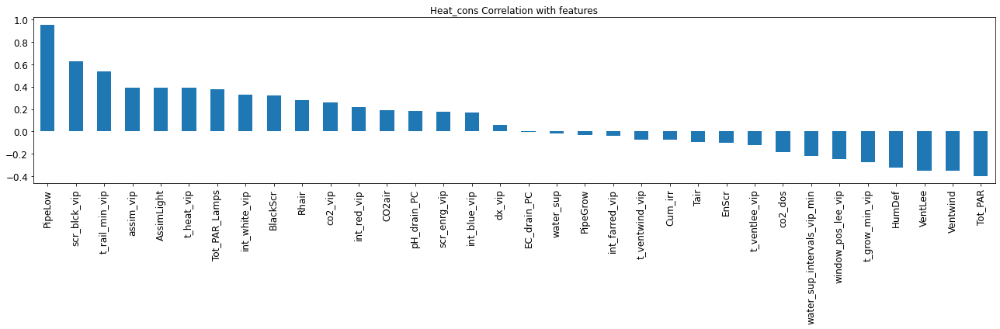

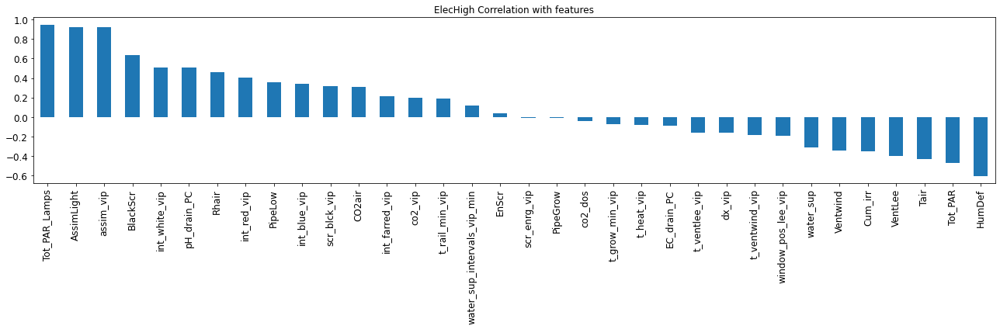

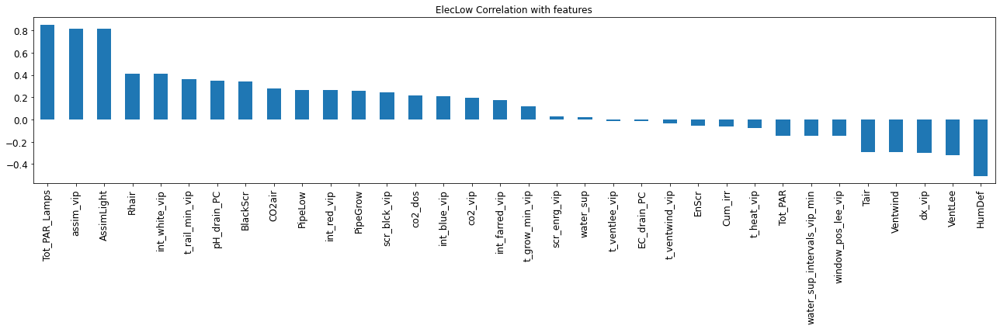

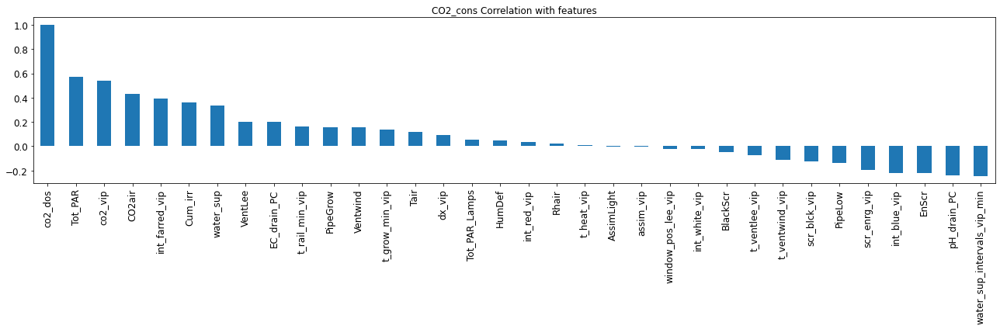

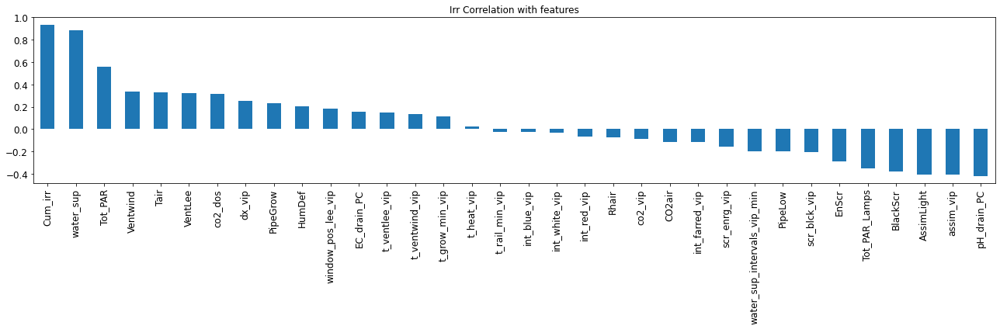

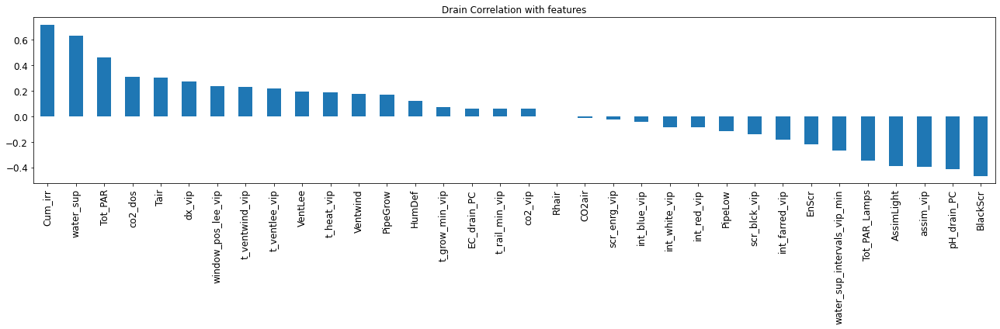

In [121]:
attributes=['Heat_cons'	,'ElecHigh',	'ElecLow',	'CO2_cons',	'Irr','Drain']
for  attribute in attributes:
    correlation=daily_data.corr()[attribute].sort_values(ascending=False).drop(teams_drc.columns)
    plt.figure()
    correlation.plot(kind='bar',title=f'{attribute} Correlation with features',figsize=(18, 6),fontsize=12)
    plt.show
    save_fig(f'{attribute}CorrelationwithFeatures')
    plt.show

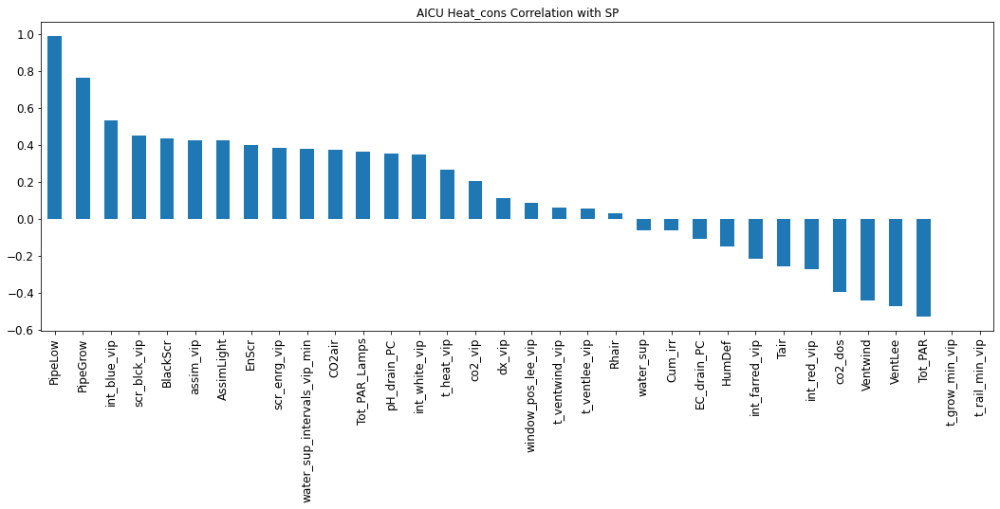

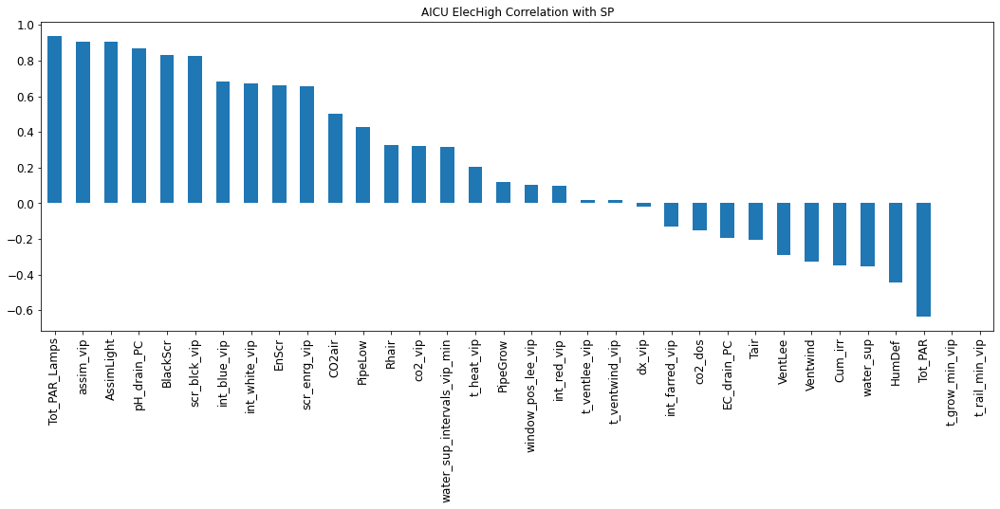

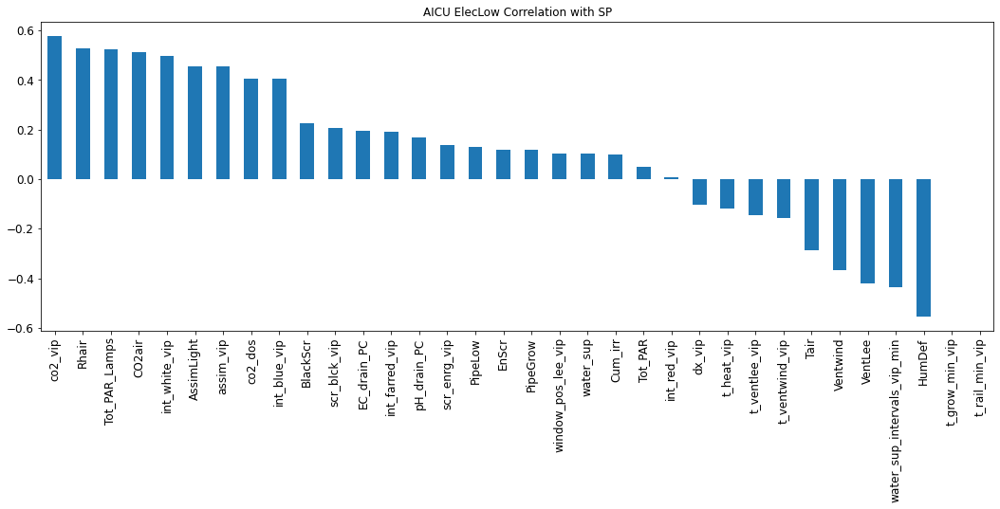

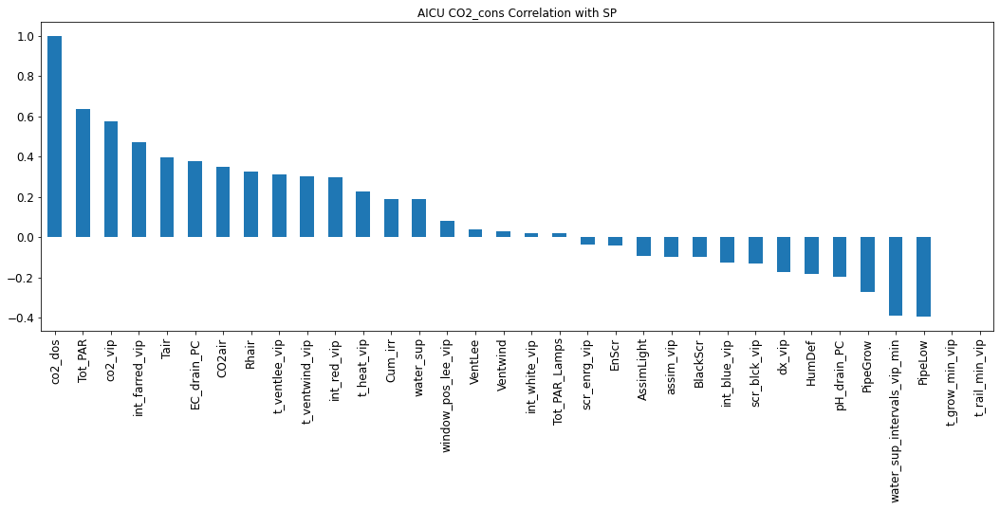

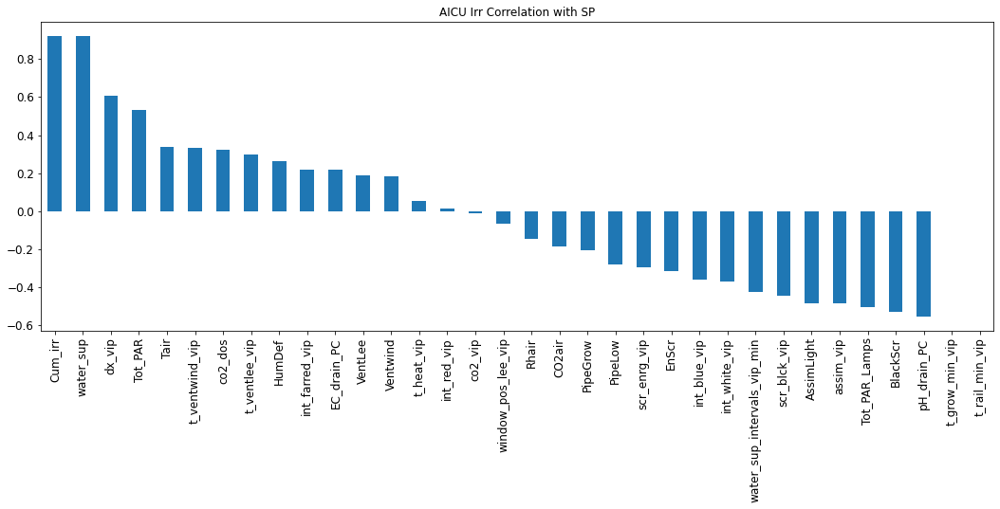

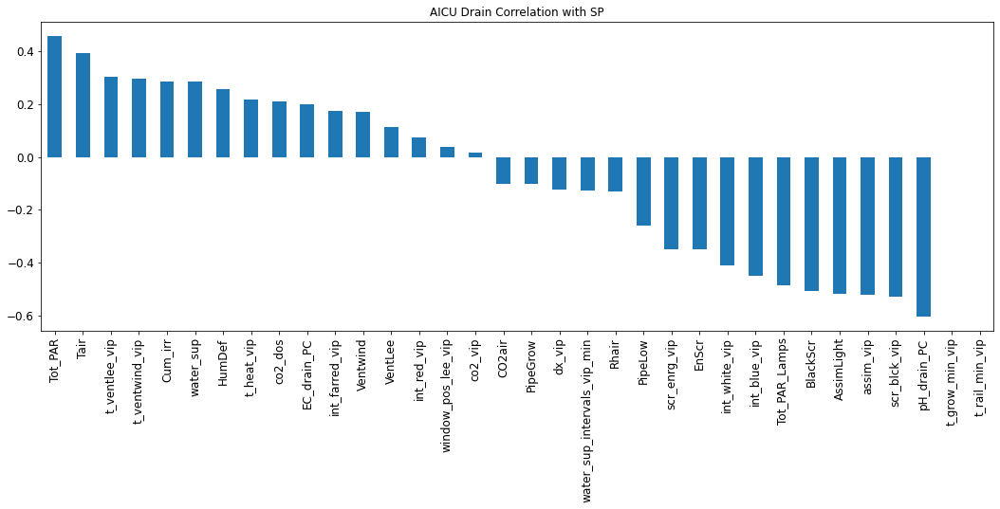

<Figure size 432x288 with 0 Axes>

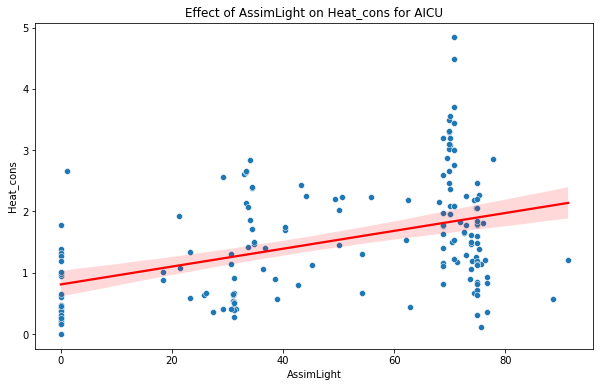

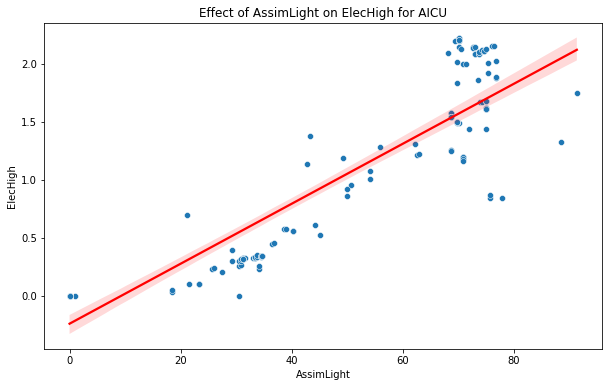

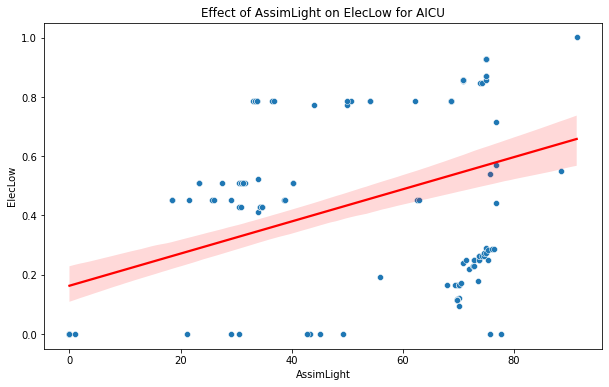

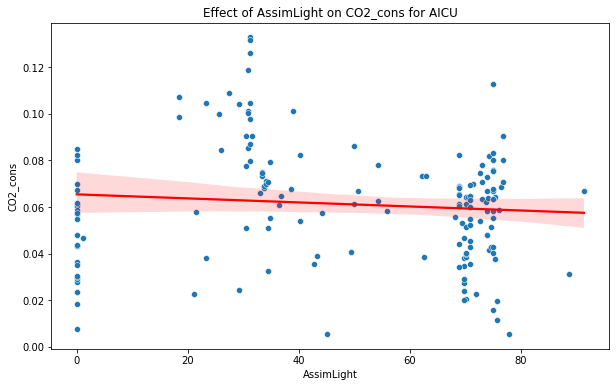

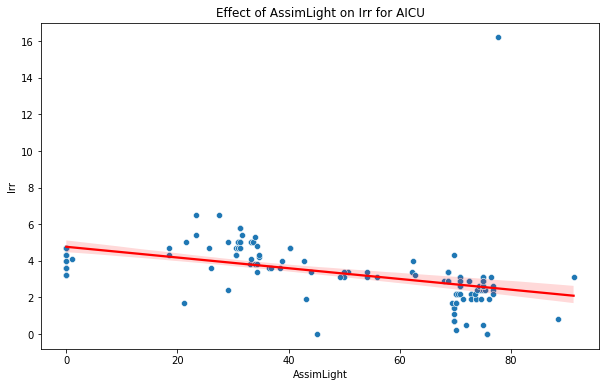

...

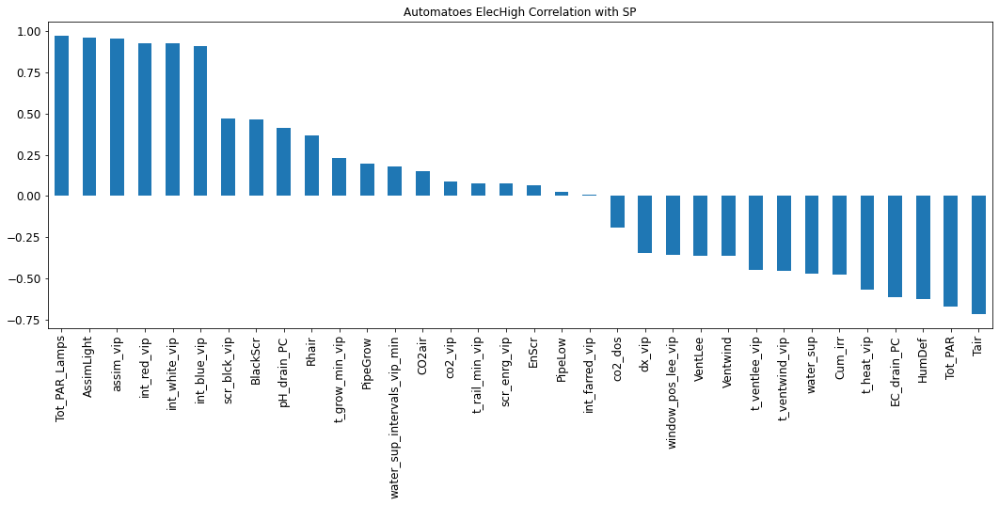

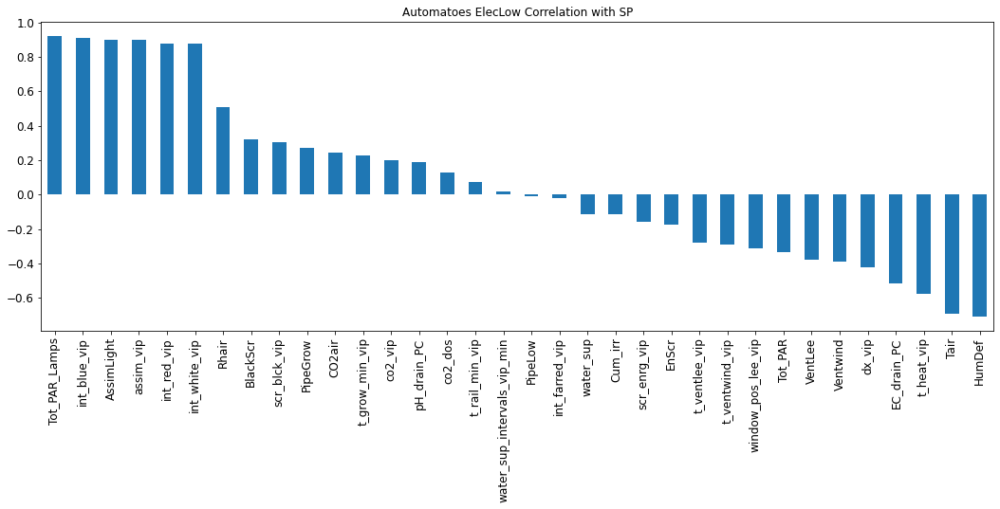

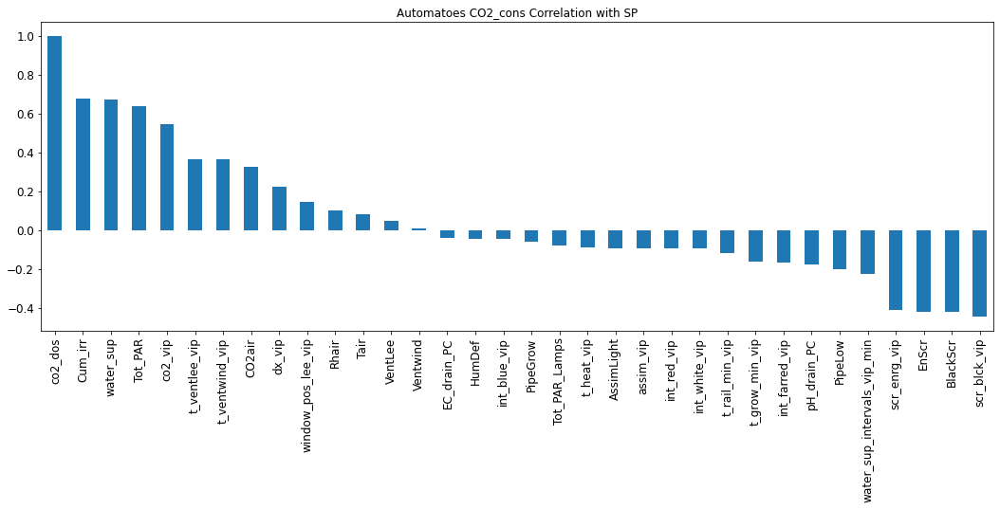

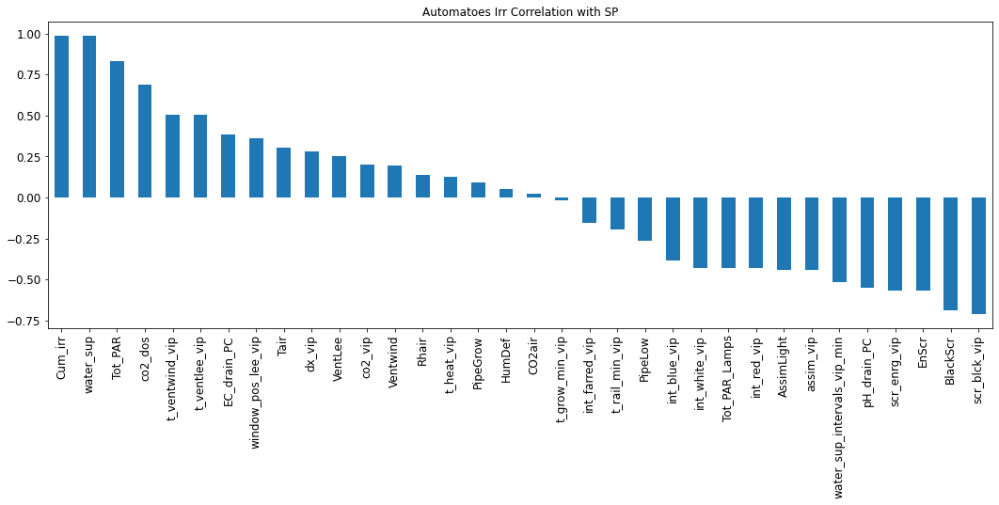

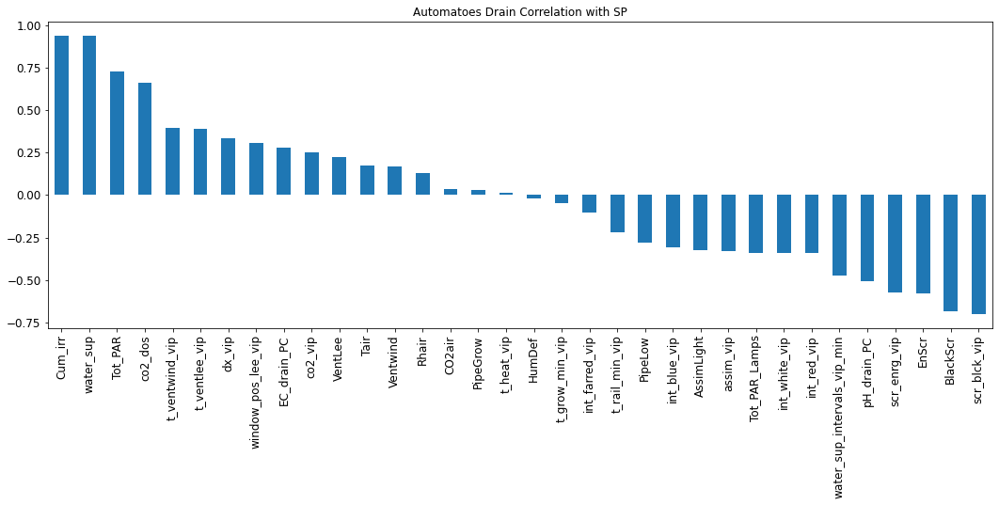

<Figure size 432x288 with 0 Axes>

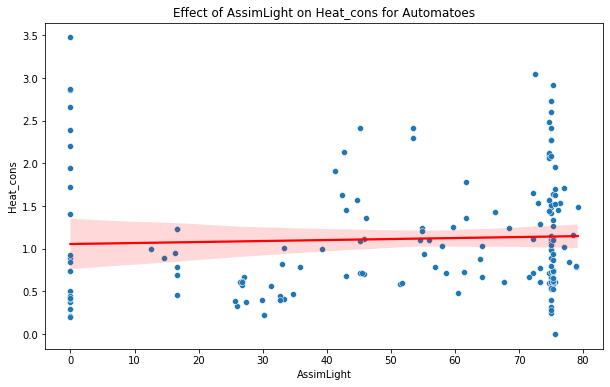

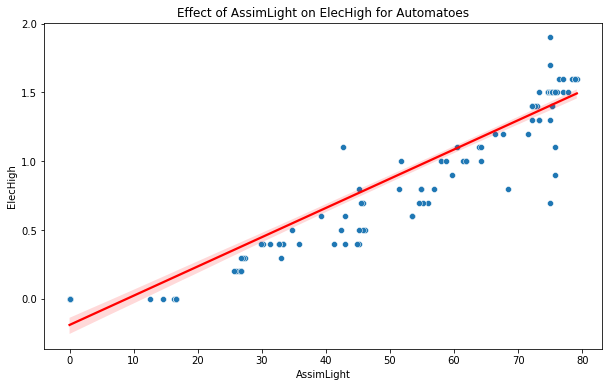

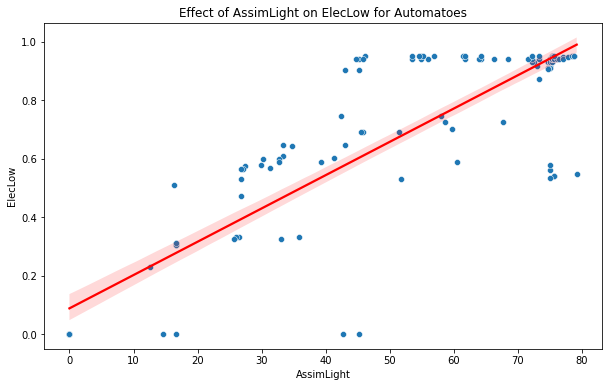

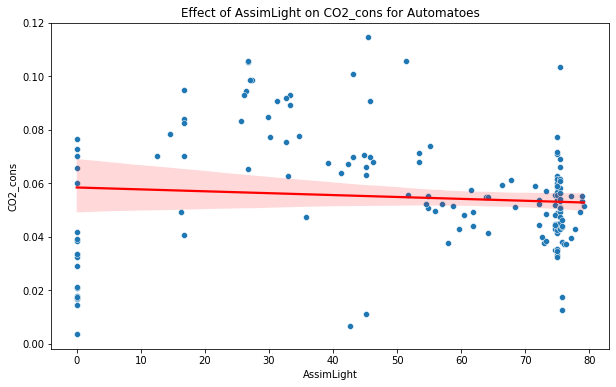

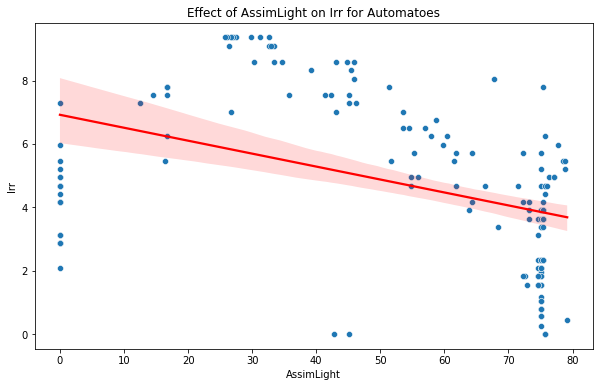

...

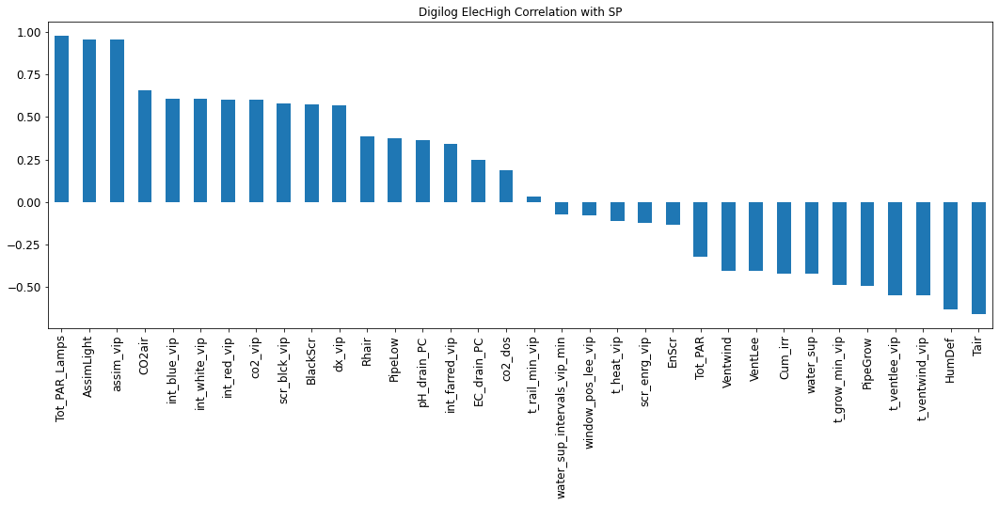

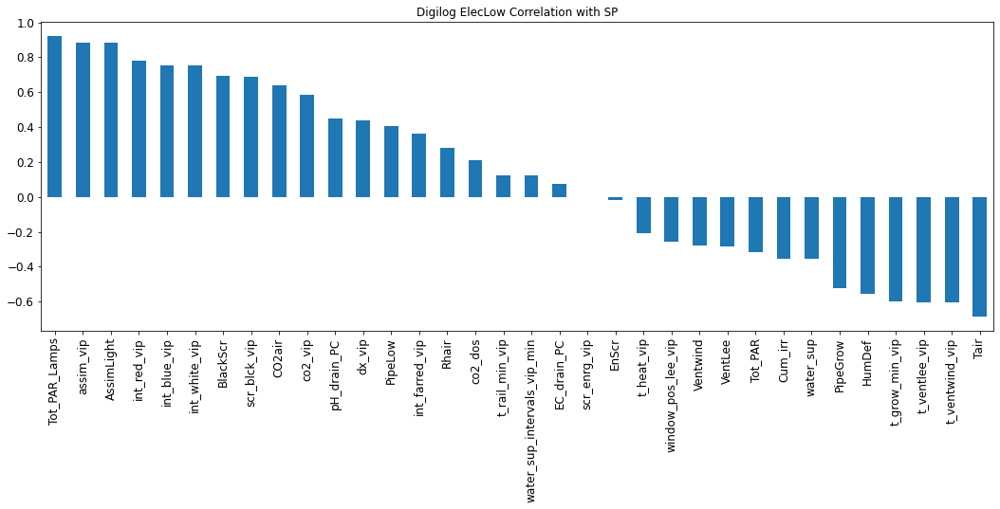

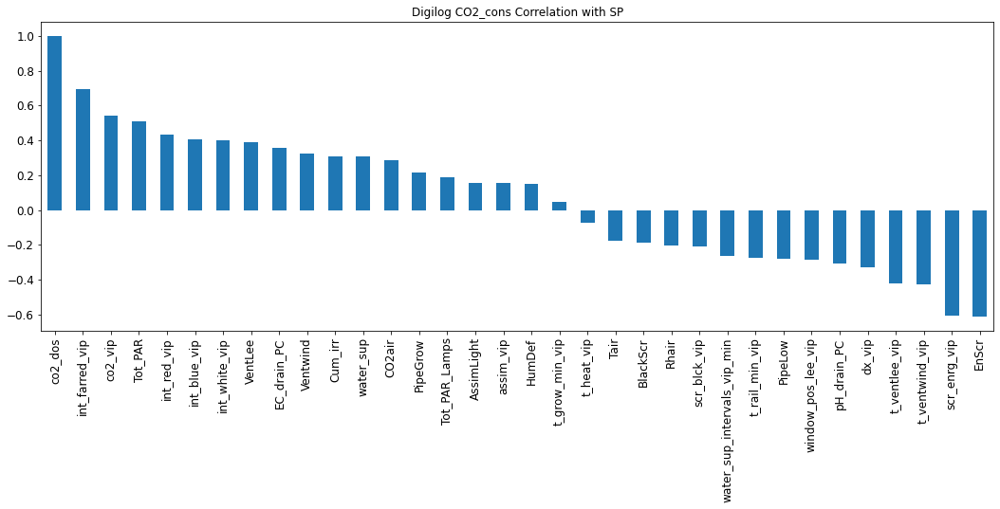

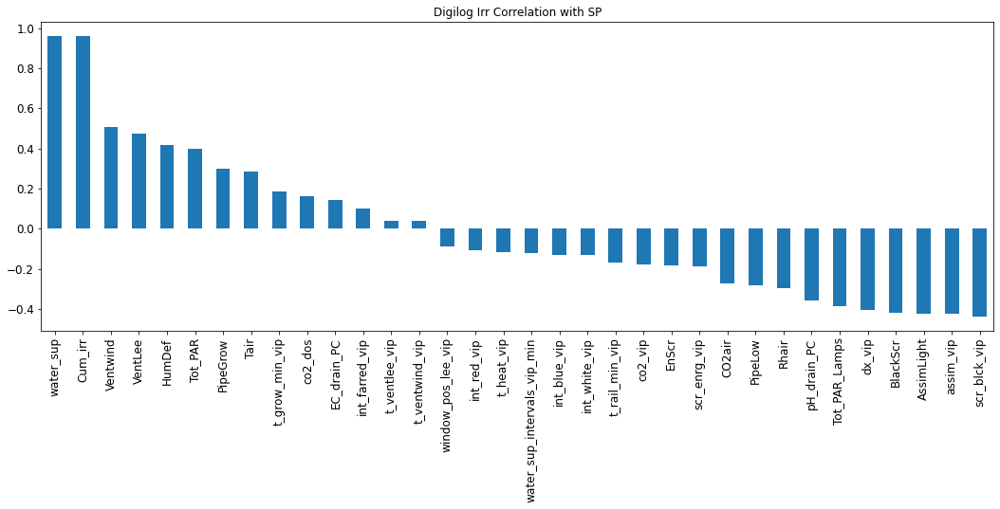

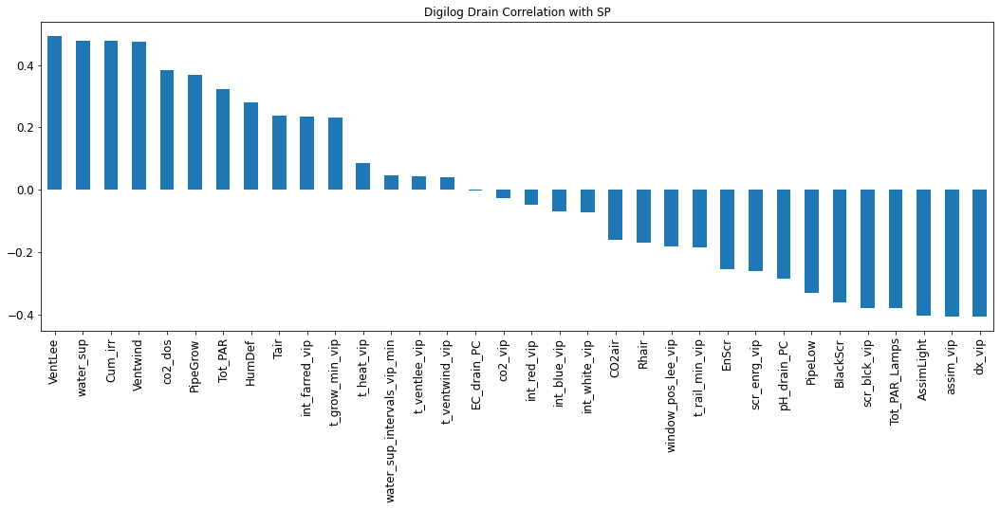

<Figure size 432x288 with 0 Axes>

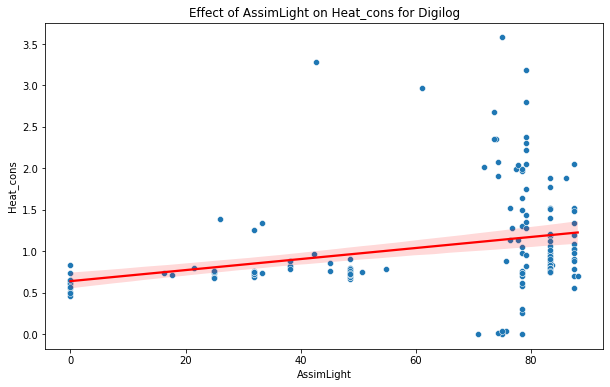

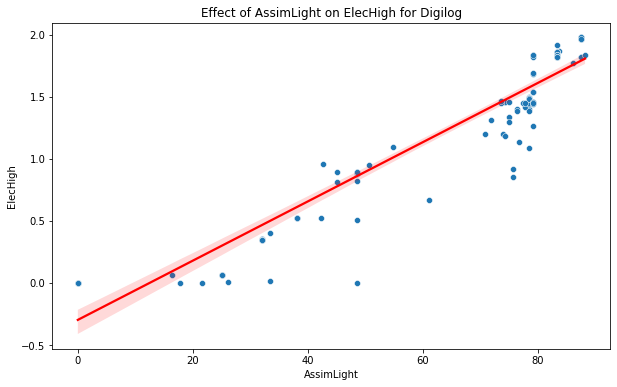

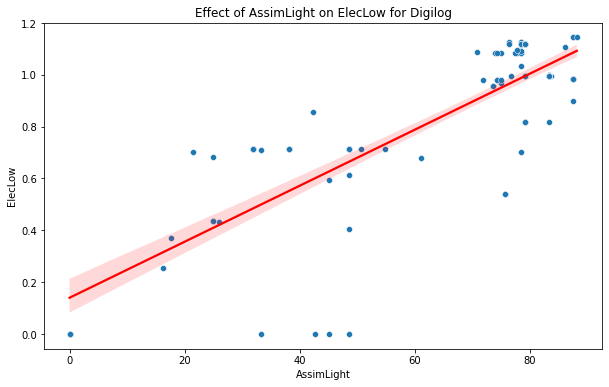

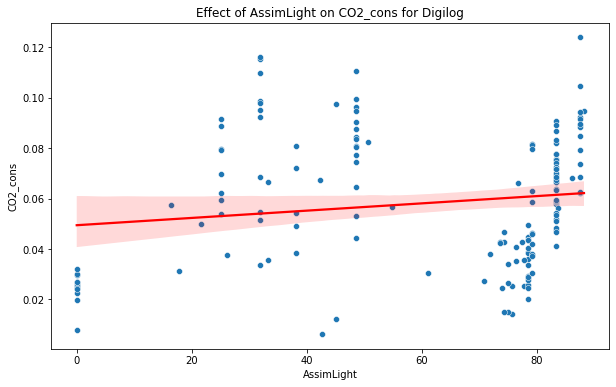

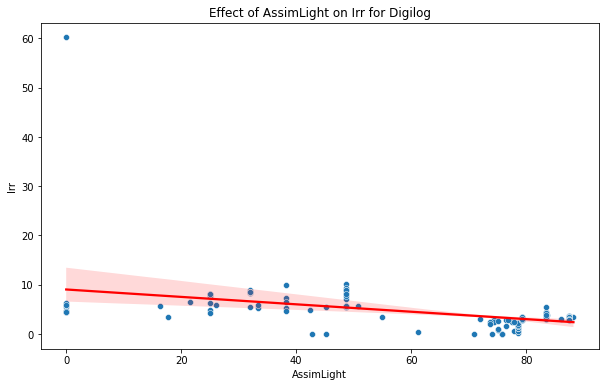

...

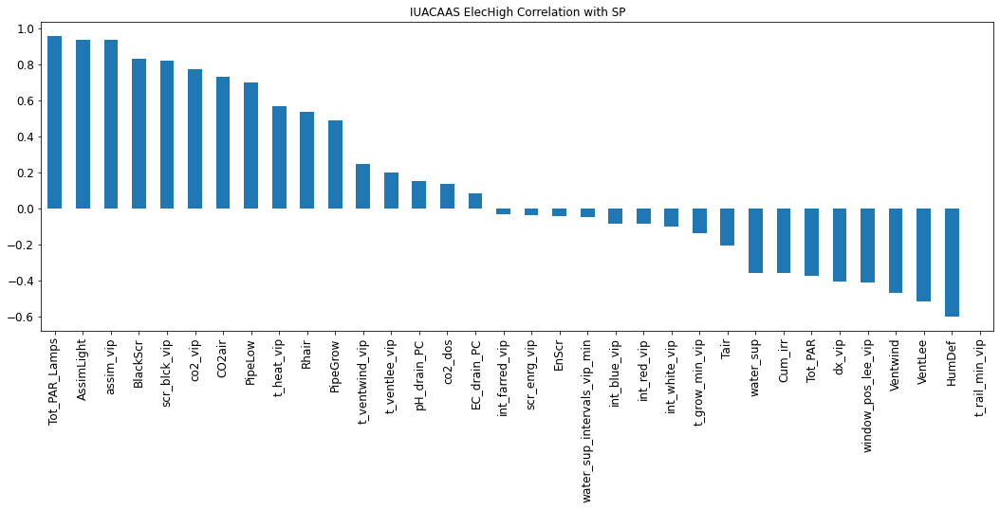

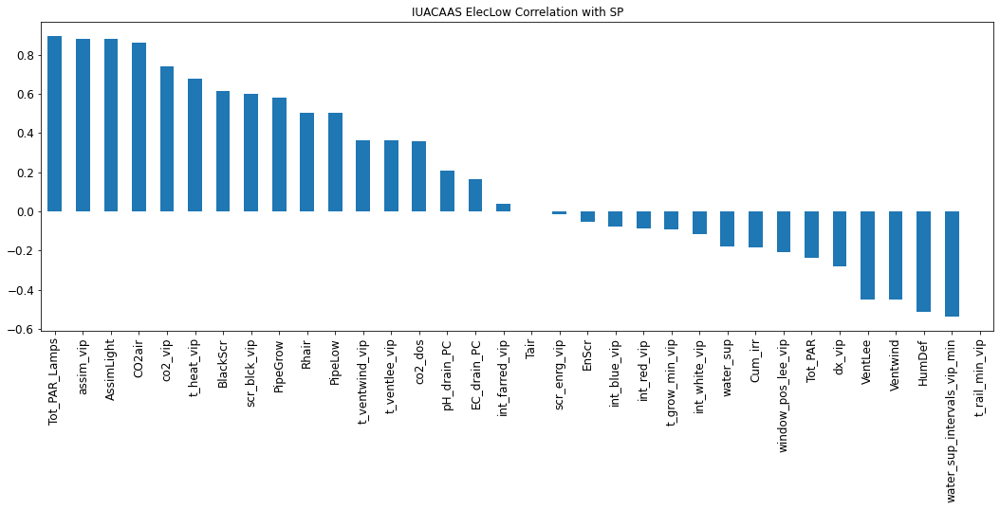

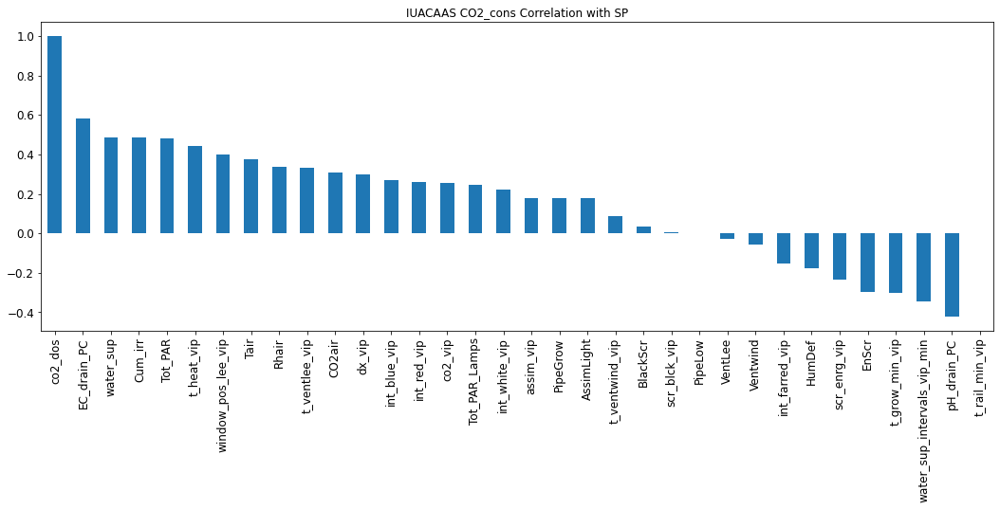

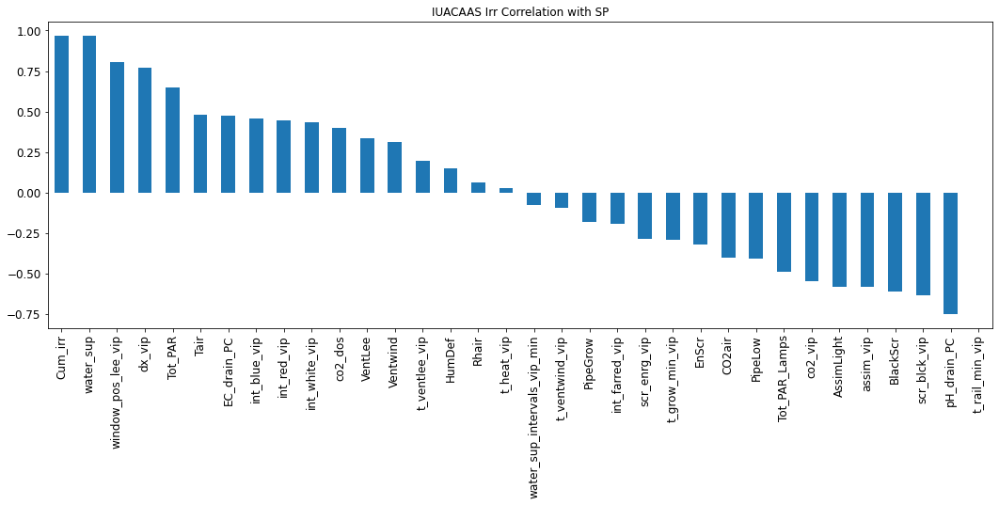

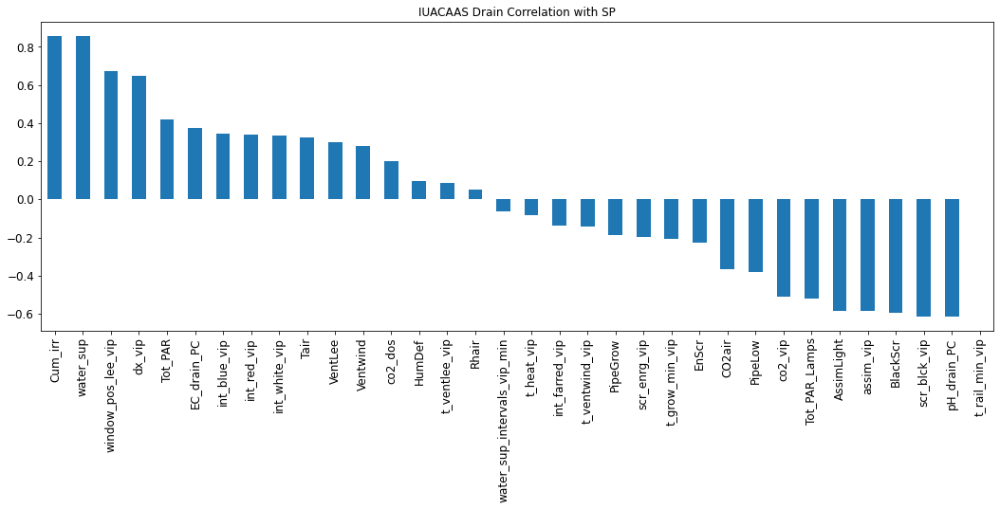

<Figure size 432x288 with 0 Axes>

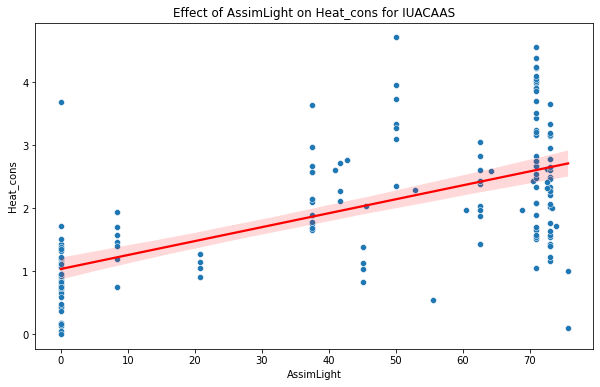

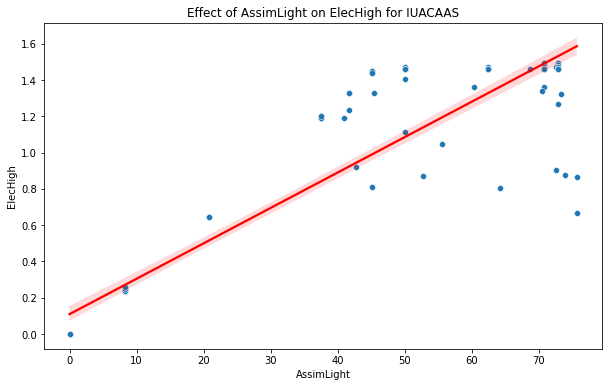

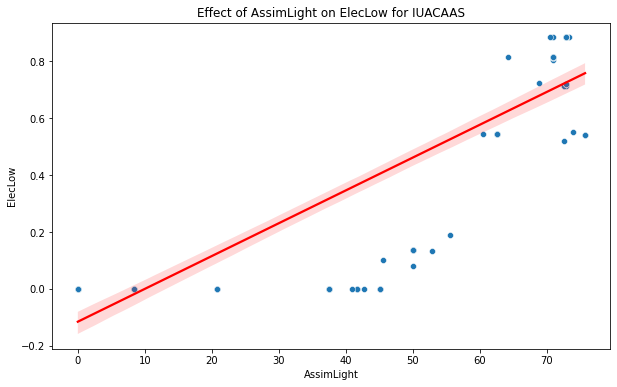

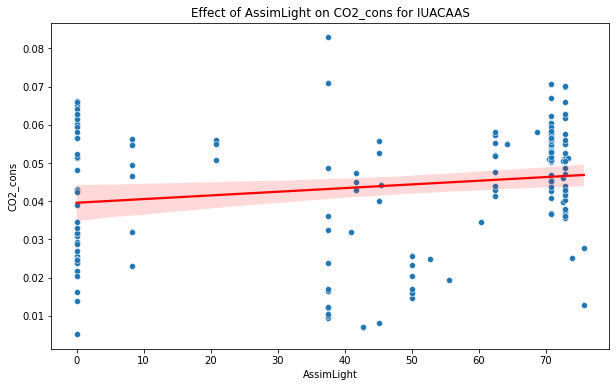

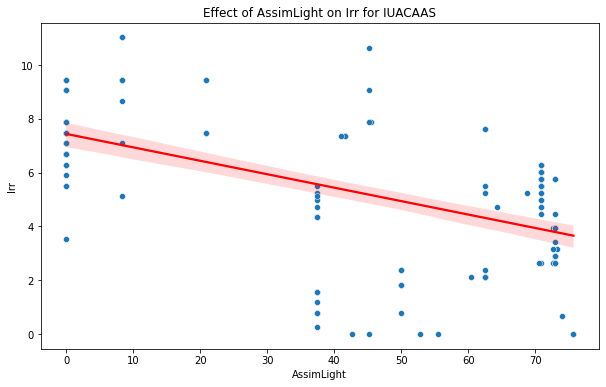

...

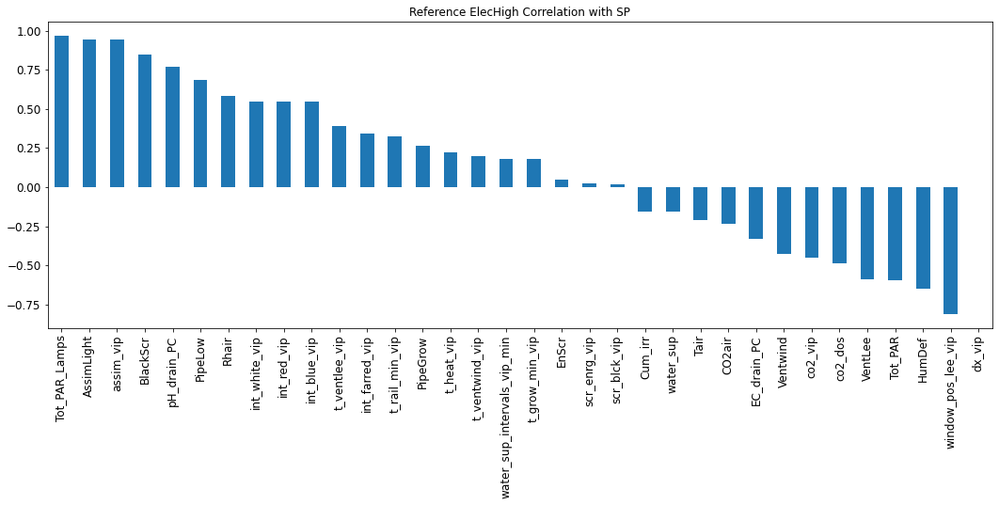

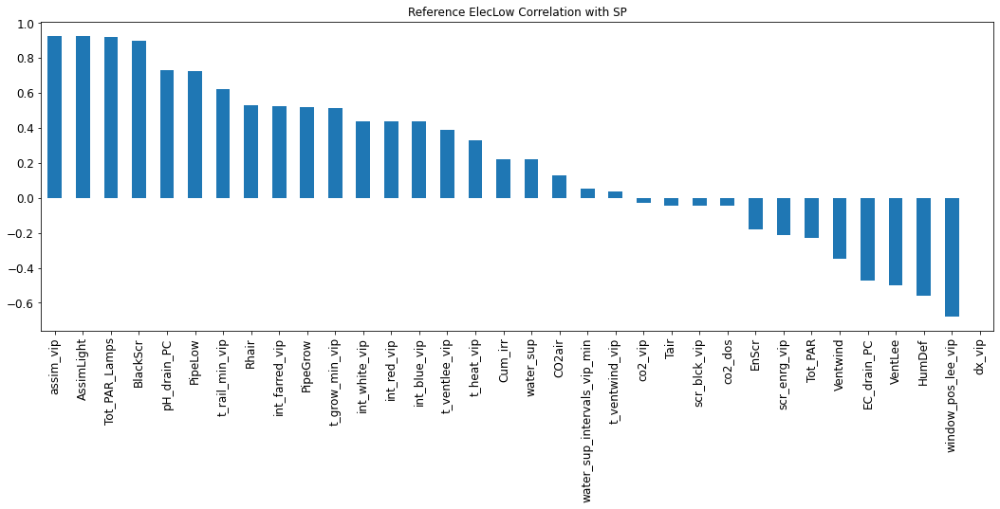

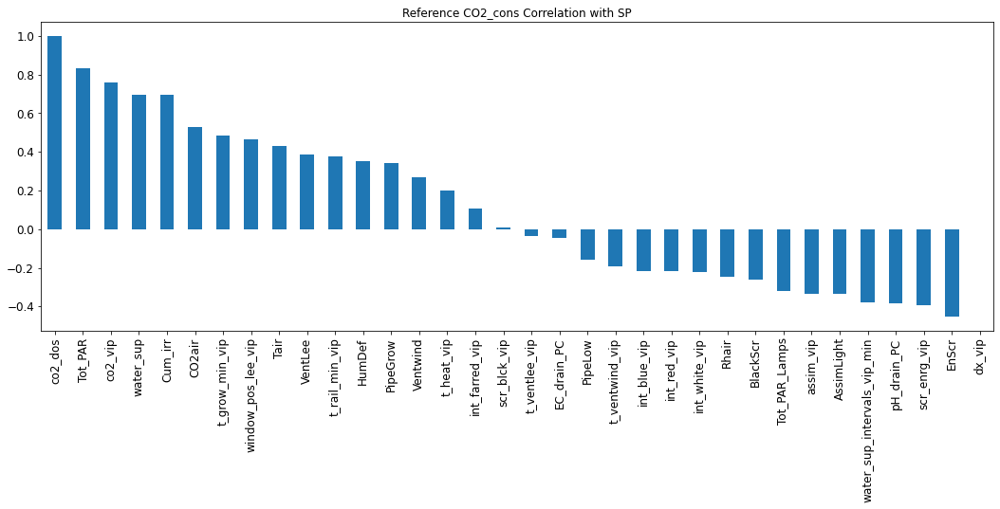

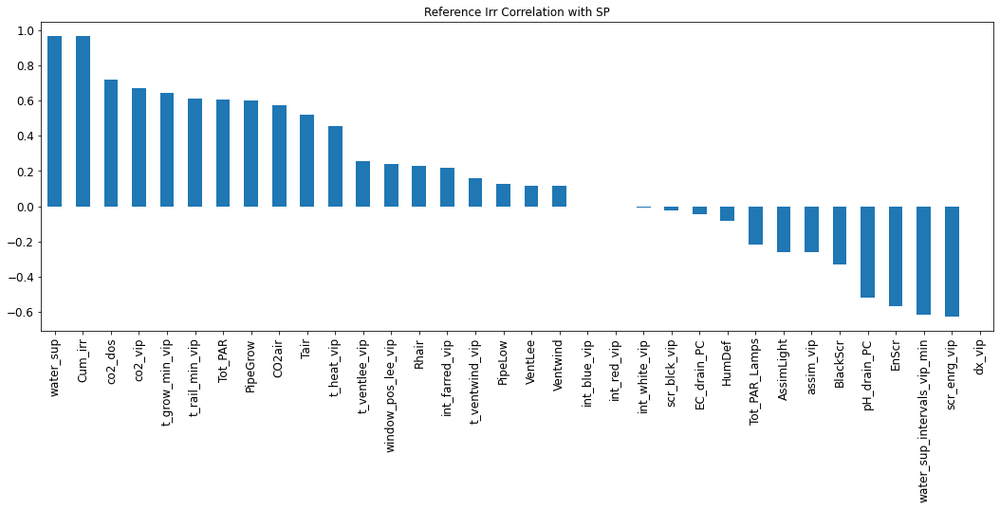

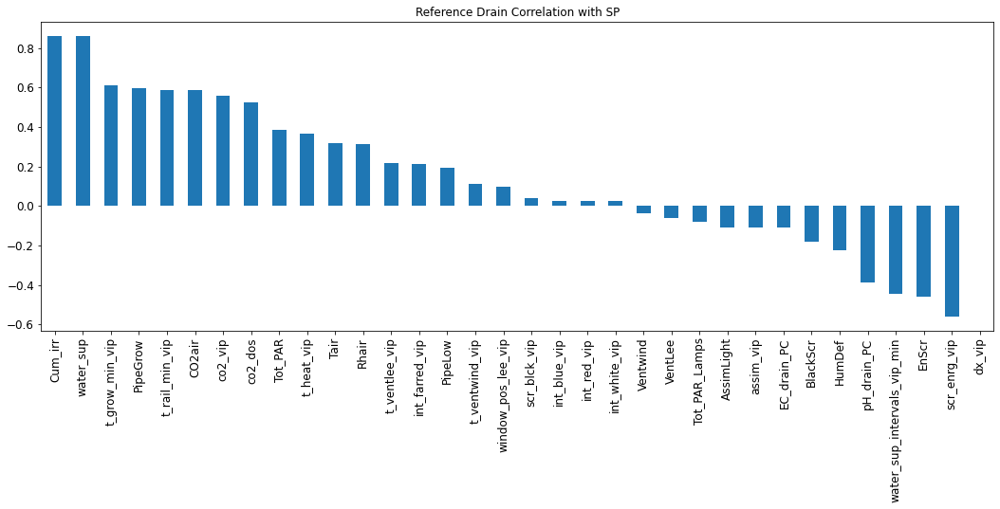

<Figure size 432x288 with 0 Axes>

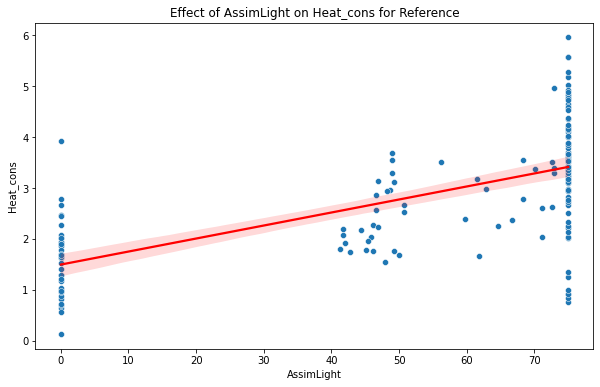

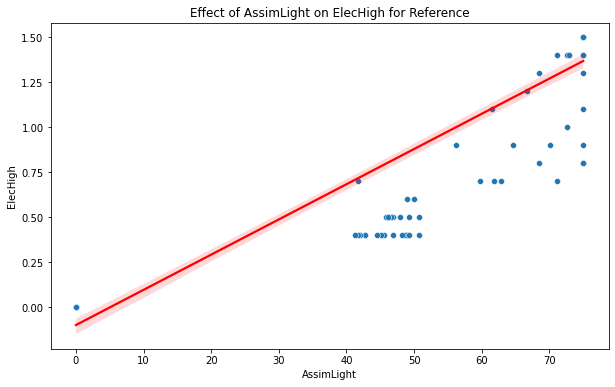

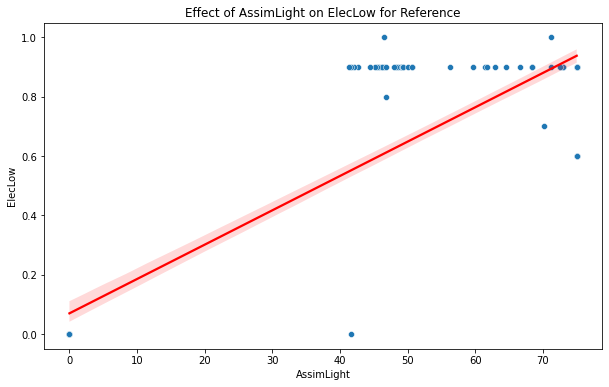

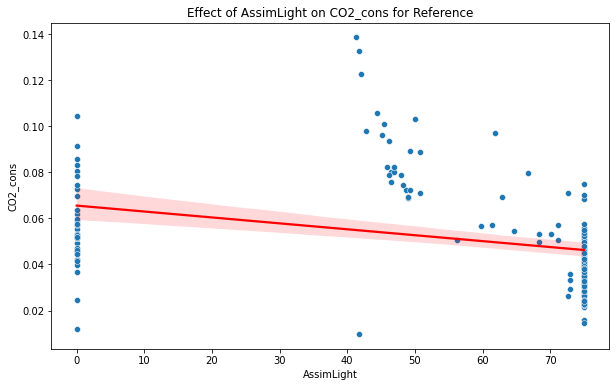

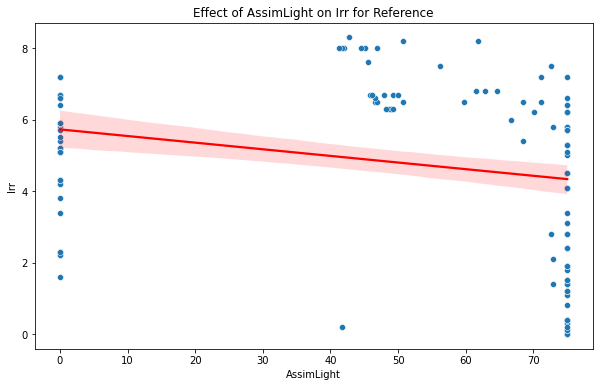

...

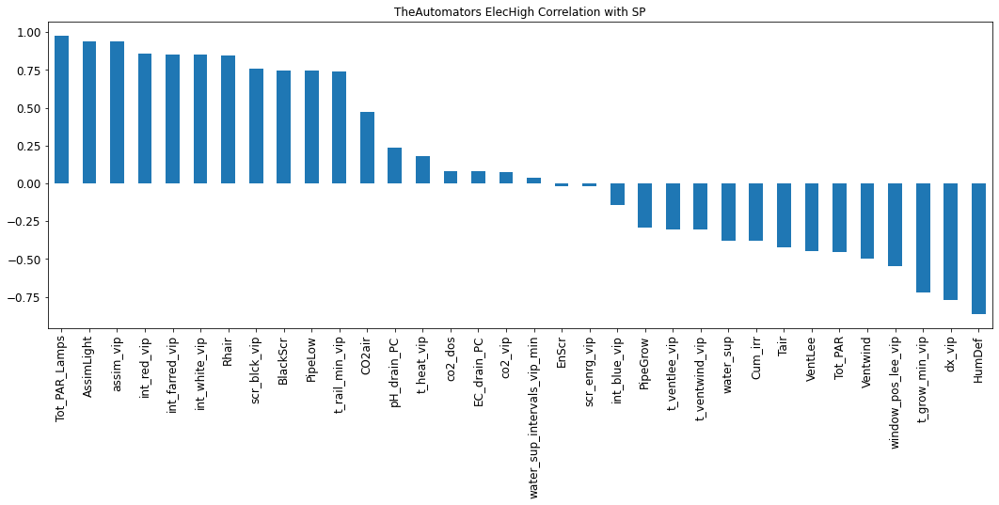

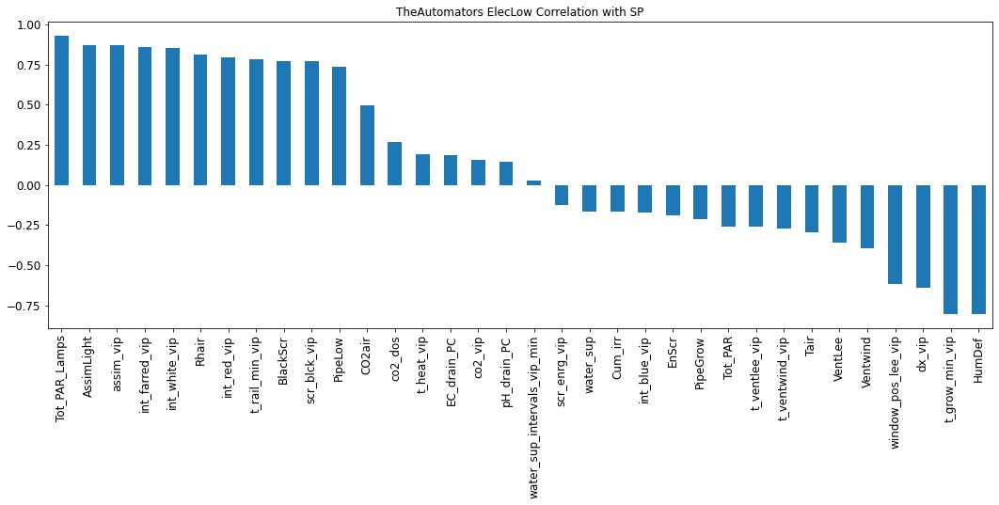

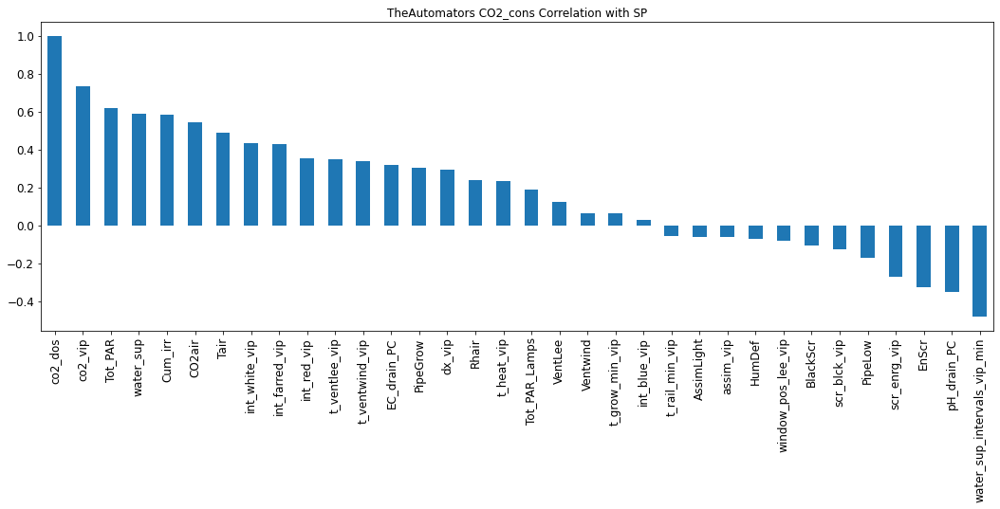

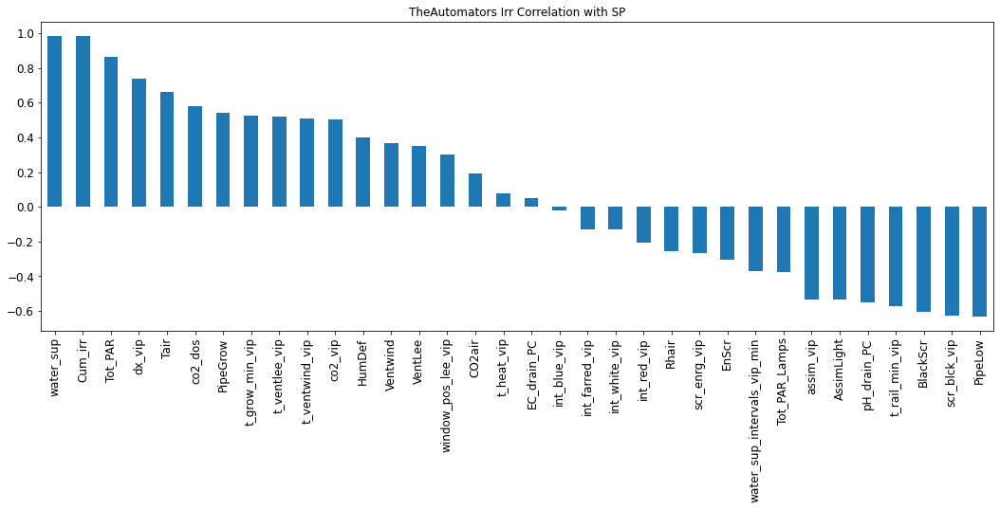

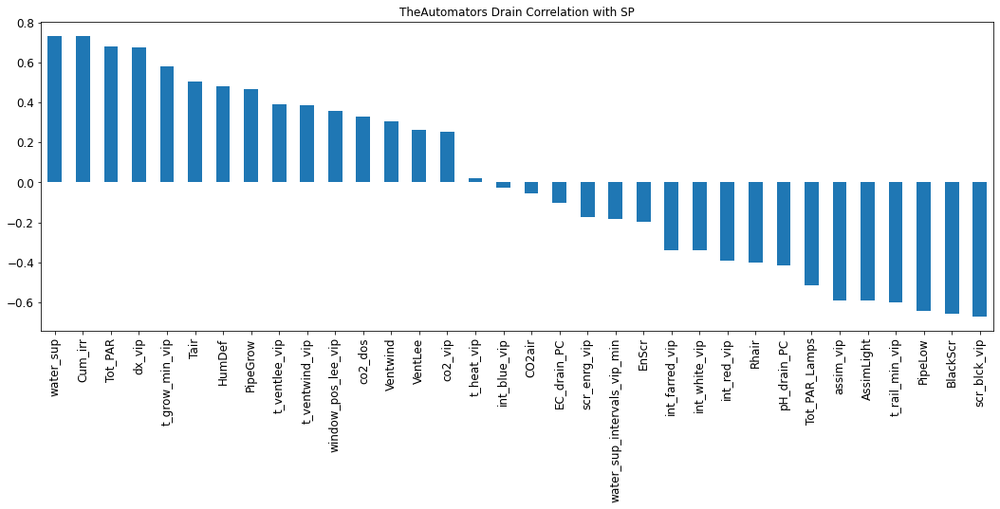

<Figure size 432x288 with 0 Axes>

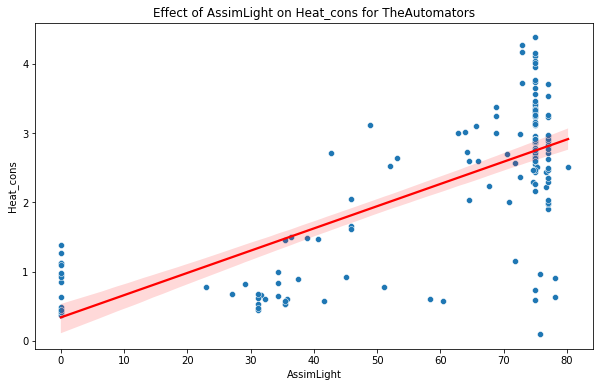

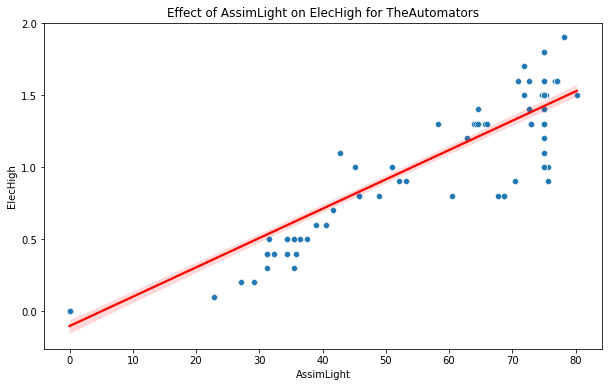

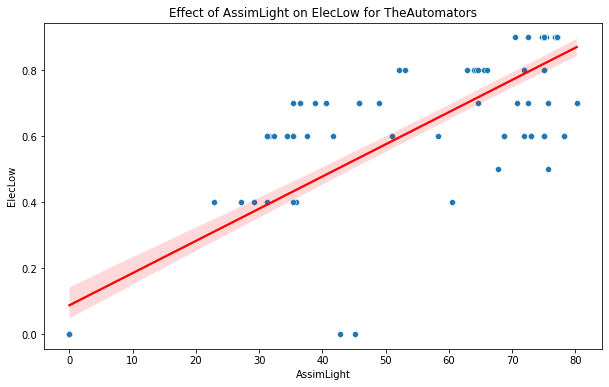

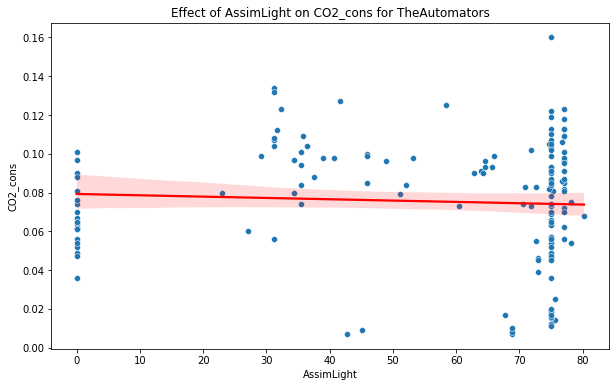

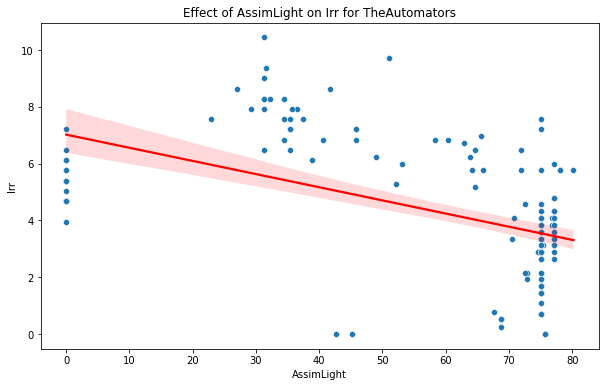

...

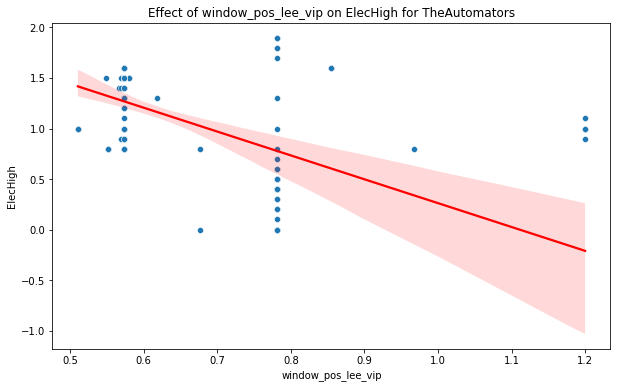

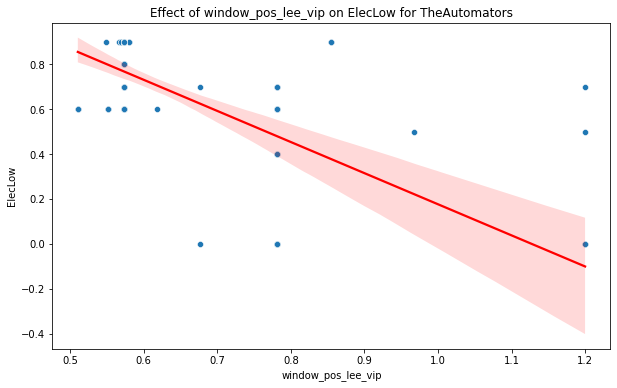

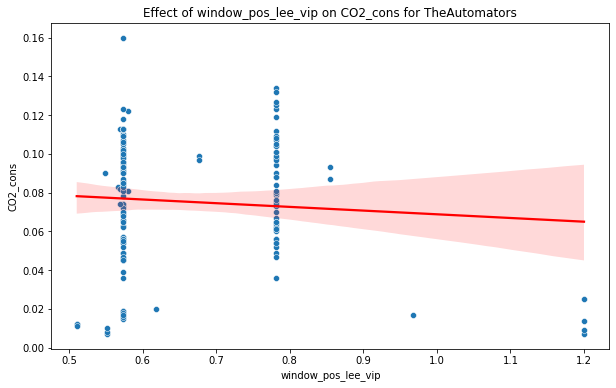

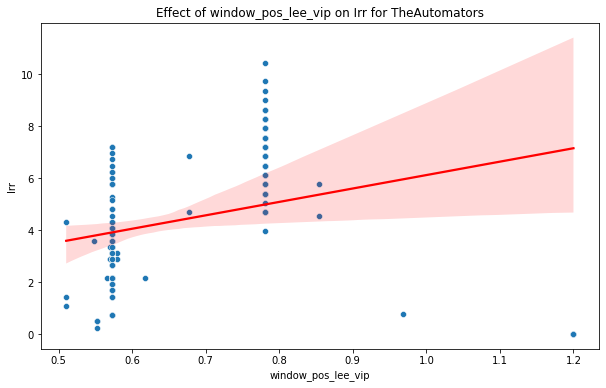

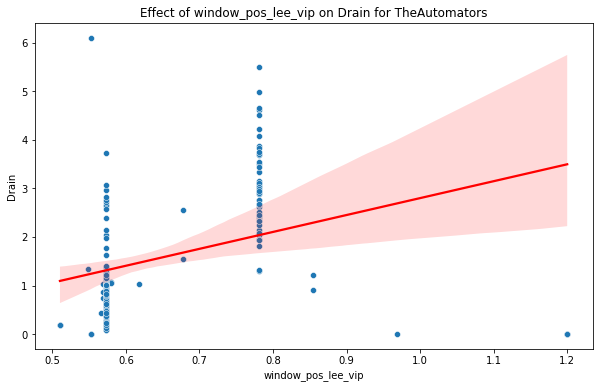

In [122]:
# Required Libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
teams_data=dict()
corr=dict()
team_corr=dict()
filenames = ['AICU', 'Automatoes',
             'Digilog', 'IUACAAS', 
             'Reference', 'TheAutomators'
             ]
for i in range(len(filenames)):

    merged_data=pd.concat([ daily_Avg[filenames[i]],Daily_Resource_Consumption[filenames[i]]], axis=1)
    
    correlation_matrix = merged_data.corr()
    
    outputs=merged_data.columns[-6:]
    
    for output in outputs:
        corr[output]=merged_data[merged_data.columns].corr()[output].sort_values(ascending=False)
        corr[output].drop(outputs,axis=0,inplace=True)
        corr[output].plot(kind='bar',title=f'{filenames[i]} {output} Correlation with SP',figsize=(18, 6),fontsize=12)
        plt.show()
        save_fig(f'{filenames[i]} {output} Correlation with SP')
        
    team_corr[filenames[i]]=corr
    # Plotting the correlation matrix
    #plt.figure(figsize=(15, 10))
    #sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm')
    #plt.title('Correlation Matrix Between SP Features and Crop Parameters')
    #plt.show()
    
    #print('control_features',merged_data.columns[:-3])
    control_features = merged_data.columns[:-6]
    
    #print('output',merged_data.columns[-5:-2])
    
    #for control_feature in control_features:
    #    plt.figure(figsize=(15, 6))
    #    sns.lineplot(data=merged_data[control_feature], palette='tab11',legend=True)           
    #    sns.lineplot(data=merged_data[outputs], palette='tab10')
#
    #    plt.title(f'Time Series of {control_feature} and CropParameters for {filenames[i]}')
    #    plt.xlabel('Date')
    #    plt.legend(loc='right')
    #    plt.show()
    #for control_feature in control_features:
    #    plt.figure(figsize=(15, 6))
    #    for output in outputs:
    #        sns.lineplot(x=merged_data[control_feature],y=merged_data[output], palette='tab10')
    #        #sns.lineplot(data=teams_ghc_weekly[output], palette='tab10')
    #plt.title(f'{control_feature} with CropParameters {filenames[i]}')
    #plt.xlabel(control_feature)
    #plt.ylabel('CropParameters')
    #plt.legend(loc='best')
    #plt.show()
    
    # Step 8: Effect of Specific Control Setpoints on Crop Parameters
    for control_feature in control_features:
        for output in outputs:
            plt.figure(figsize=(10, 6))
            sns.scatterplot(data=merged_data, x=control_feature, y=output)
            sns.regplot(data=merged_data, x=control_feature, y=output, scatter=False, color='red')
            plt.title(f'Effect of {control_feature} on {output} for {filenames[i]}')
            plt.show()

    teams_data[filenames[i]]=merged_data

In [123]:
import plotly.express as px
#add 'AssimLight', 'CO2air', 'Cum_irr','HumDef', 'Rhair', 'Tair', 'Tot_PAR','Tot_PAR_Lamps', 'co2_dos',
features=[       'co2_vip', 'dx_vip', 'int_blue_vip', 'int_farred_vip', 'int_red_vip',
       'int_white_vip', 'pH_drain_PC', 'scr_blck_vip','t_heat_vip',
       'water_sup_intervals_vip_min']
# Step 10: Advanced Visualizations
for feature in features:
    for output in outputs:
        # Interactive Scatter Plot with Plotly
        fig = px.scatter(daily_data, x=feature, y=output, color=[filenames[i] for x in range(166) for i in range(len(filenames))])       
        fig.update_layout(title=f'Interactive Scatter Plot: {feature} vs. {output}')
        fig.show()

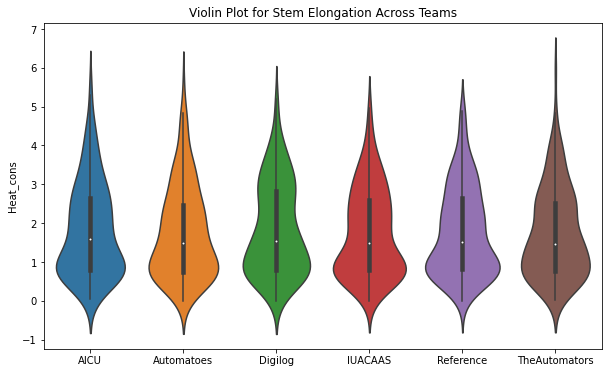

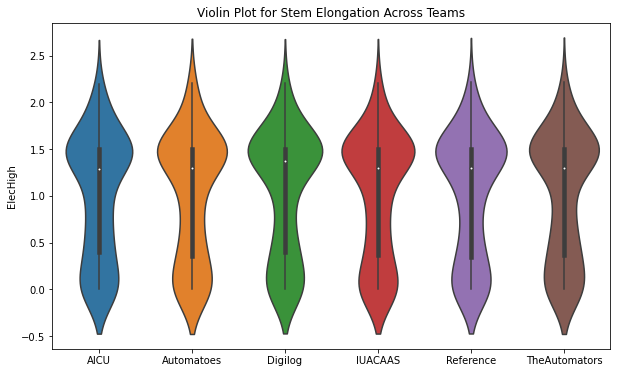

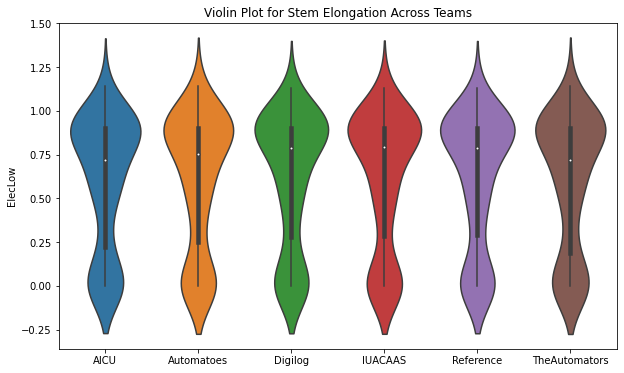

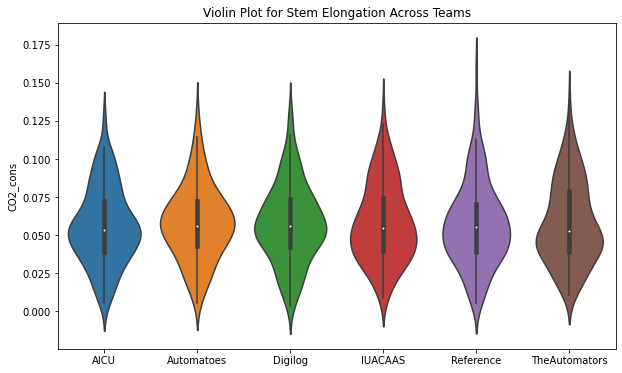

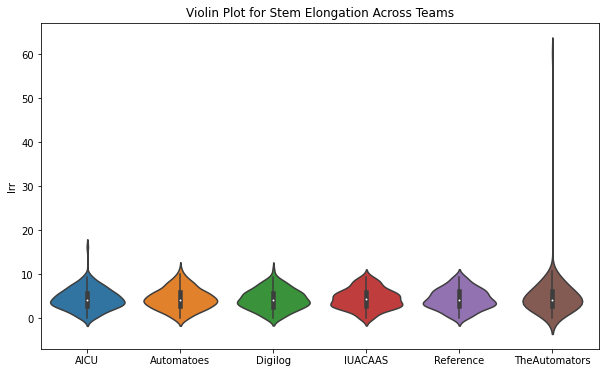

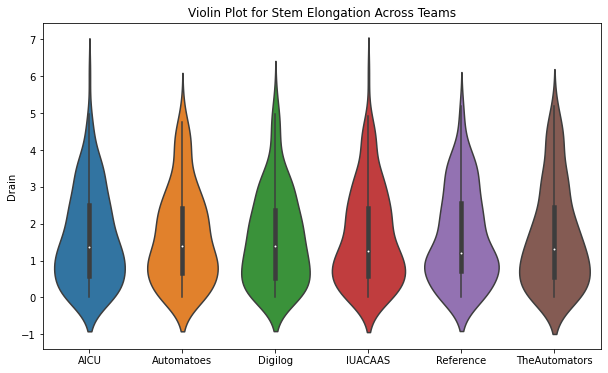

In [124]:
import plotly.express as px
import seaborn as sns
# Violin Plot to Compare Distributions
for output in outputs:
    plt.figure(figsize=(10, 6))
    sns.violinplot(data=daily_data, x=[filenames[i] for x in range(166)  for i in range(len(filenames))], y=output)
    plt.title('Violin Plot for Stem Elongation Across Teams')
    plt.show()



In [125]:
for i in range(len(filenames)):
        Daily_Resource_Consumption[filenames[i]]['%time'] = pd.to_datetime(Daily_Resource_Consumption[filenames[i]].index.str.split('_').str[0])
        Daily_Resource_Consumption[filenames[i]].set_index('%time', inplace=True)  # Set datetime as the index


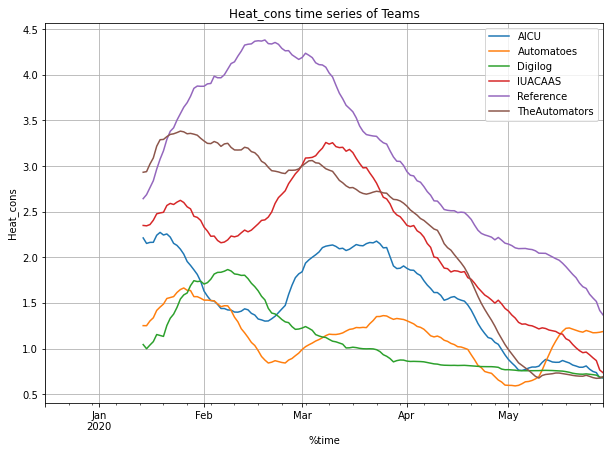

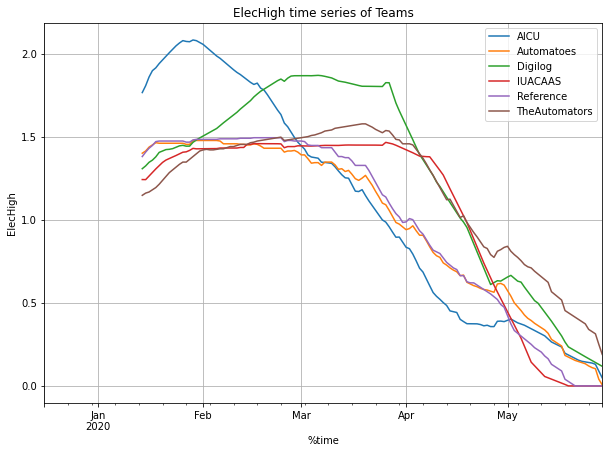

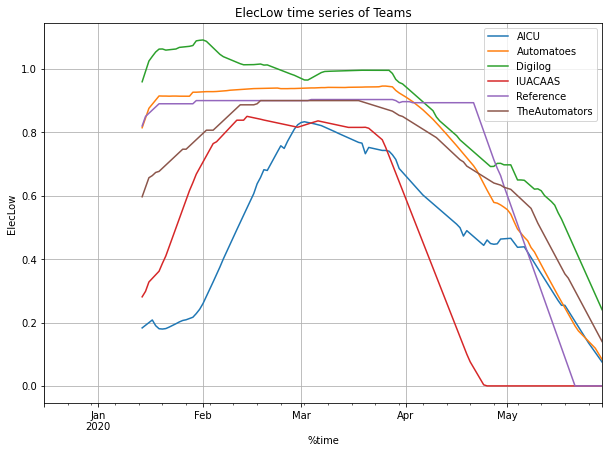

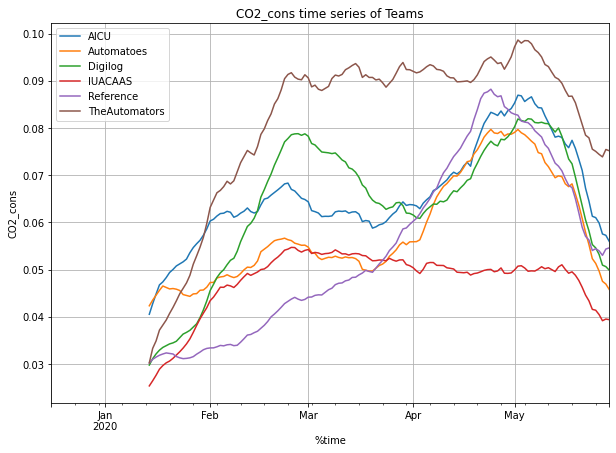

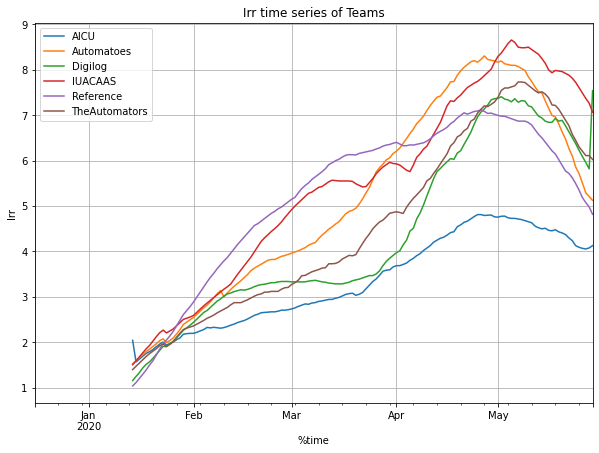

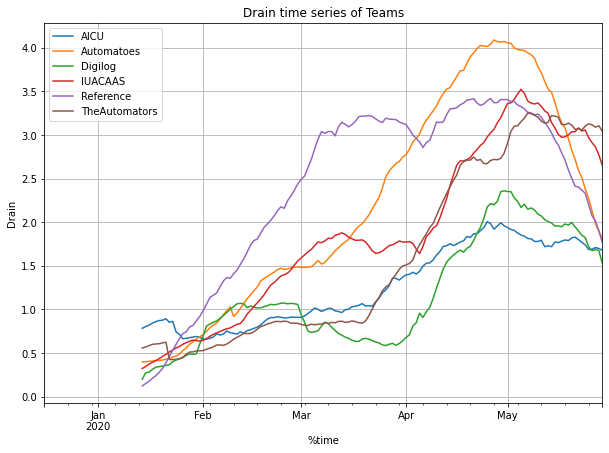

In [126]:
for feature in Daily_Resource_Consumption[filename].columns:
    fig = plt.figure(figsize=(10, 7))
    ax = fig.gca()
    for i in range(len(filenames)):
        
        davg = Daily_Resource_Consumption[filenames[i]][feature]#.resample('h').mean()  # compute the mean for each hour
        #weekly_avg = Weekly_Crop_Parameters[filenames[i]][output].resample('W').mean()
        #print(dayly_avg)
        period=slice("2019-12-16 00:00:00", "2020-05-30 00:00:00")
        rolling_average_daily = davg[period].rolling(window=30).mean()
        #rolling_average_weekly = weekly_avg[period].rolling(window=4).mean()

        rolling_average_daily.plot(grid=True,legend=True,label=f'{filenames[i]}')
    ax.set_xlabel(xlabel='%time')
    ax.set_ylabel(ylabel=f'{feature}')
    ax.set_title(f'{feature} time series of Teams')

    plt.show()

#add the legend for each line of plot which represent the file_name

In [127]:
# import the necessary packages
import json   
from math import floor
from keras.preprocessing.image import ImageDataGenerator
from keras.applications import vgg19
from keras.layers import AveragePooling2D,Dropout,Flatten,Dense,Activation,Input,MaxPooling2D
from keras.models import Model
from keras.optimizers import Adam
from keras.applications.vgg19 import preprocess_input
from keras.utils import to_categorical
from sklearn.preprocessing import OneHotEncoder,LabelEncoder,StandardScaler,MinMaxScaler
from sklearn.preprocessing import LabelBinarizer

from keras.callbacks import LearningRateScheduler
from keras.callbacks import EarlyStopping,ModelCheckpoint
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report,confusion_matrix,multilabel_confusion_matrix
from imutils import paths
import matplotlib.pyplot as plt
import numpy as np
import argparse
import os
import cv2
from sklearn.metrics import mean_squared_error,r2_score


In [128]:
daily_data.duplicated().sum()

0

In [132]:
labels = daily_data[attributes]
data = daily_data.drop(attributes,axis=1)

np.save('daily_data.npy', data)
np.save('daily_labels.npy', labels)

print('data',data.shape)
print('labels',labels.shape)

#data = np.load("data.npy")
#labels = np.load("labels.npy")

#testY=ss_y.transform(testY)

#testY=pd.DataFrame(testY,columns=[labels.columns])


#splitting the data into test and train
(trainX, testX, trainY, testY) = train_test_split(data, labels,shuffle=True,
	test_size=0.2, random_state=42)

#(trainX, validX, trainY, validY) = train_test_split(trainX, trainY,shuffle=True,
#	test_size=0.2, random_state=42)

ss_x=MinMaxScaler()
trainX=ss_x.fit_transform(trainX)
testX=ss_x.transform(testX)

ss_y=MinMaxScaler()
trainY=ss_y.fit_transform(trainY)
testY=ss_y.transform(testY)

print('trainX',trainX.shape)
print('trainY',trainY.shape)
print('testX',testX.shape)
print('testY',testY.shape)
#print('validX',validX.shape)
#print('validY',validY.shape)


#SS = StandardScaler()
#
#trainX = SS.fit_transform(trainX)
#validX = SS.transform(validX)
#testX= SS.transform(testX)


np.save('trainX_DailyResourceConsumptionRegression.npy', trainX)
np.save('trainY_DailyResourceConsumptionRegression.npy', trainY)

np.save('testX_DailyResourceConsumptionRegression.npy', testX)
np.save('testY_DailyResourceConsumptionRegression.npy', testY)

#np.save('validX_DailyResourceConsumptionRegression.npy', validX)
#np.save('validY_DailyResourceConsumptionRegression.npy', validY)



#trainX = np.load("trainX_DHRegression.npy")
#trainY = np.load("trainY_DHRegression.npy")
#testX = np.load("testX_DHRegression.npy")
#testY = np.load("testY_DHRegression.npy")
#validX = np.load("validX_DHRegression.npy")
#validY = np.load("validY_DHRegression.npy")

trainX=pd.DataFrame(trainX,columns=data.columns)
testX=pd.DataFrame(testX,columns=data.columns)
trainY=pd.DataFrame(trainY,columns=labels.columns)
testY=pd.DataFrame(testY,columns=labels.columns)


print('trainX',trainX.min(),trainX.max())
print('trainY',trainY.min(),trainY.max())
print('testX',testX.min(),testX.max())
print('testY',testY.min(),testY.max())







data (996, 34)
labels (996, 6)
trainX (796, 34)
trainY (796, 6)
testX (200, 34)
testY (200, 6)
trainX AssimLight                     0.0
BlackScr                       0.0
CO2air                         0.0
Cum_irr                        0.0
EC_drain_PC                    0.0
EnScr                          0.0
HumDef                         0.0
PipeGrow                       0.0
PipeLow                        0.0
Rhair                          0.0
Tair                           0.0
Tot_PAR                        0.0
Tot_PAR_Lamps                  0.0
VentLee                        0.0
Ventwind                       0.0
assim_vip                      0.0
co2_dos                        0.0
co2_vip                        0.0
dx_vip                         0.0
int_blue_vip                   0.0
int_farred_vip                 0.0
int_red_vip                    0.0
int_white_vip                  0.0
pH_drain_PC                    0.0
scr_blck_vip                   0.0
scr_enrg_vip           

In [130]:
from sklearn.pipeline import Pipeline,make_pipeline
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import LinearSVR 
from sklearn.svm import SVR
from sklearn.model_selection import cross_val_score,cross_val_predict
import numpy as np
from sklearn.compose import ColumnTransformer,make_column_selector
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler,OneHotEncoder
from sklearn.ensemble import GradientBoostingRegressor,AdaBoostRegressor
from sklearn.linear_model import Lasso,Ridge,ElasticNet
from sklearn.preprocessing import FunctionTransformer


In [133]:
#Multioutput Regression

models={#'LinearRegression':LinearRegression(fit_intercept=True,positive=True,n_jobs=-1),
        'RandomForest':RandomForestRegressor( random_state = 42,
                                            n_estimators=80,criterion='squared_error',
                                            max_depth= None, min_samples_split = 2, min_samples_leaf= 1, min_weight_fraction_leaf = 0,
                                            max_features='sqrt',max_leaf_nodes = None, min_impurity_decrease = 0, bootstrap=True,
                                            oob_score  = False, n_jobs = None, verbose = 0, warm_start = True,
                                            ccp_alpha = 0, max_samples=None
                                             ),
        'GradientBoosting':GradientBoostingRegressor(random_state=42),
        'AdaBoost':AdaBoostRegressor(random_state=42),
        'KNeighborsRegressor':KNeighborsRegressor(n_neighbors= 7, weights='distance', algorithm='ball_tree', leaf_size = 50,
                                                   p= 4, metric = "minkowski",metric_params = None, n_jobs=-1),
        'DecisionTree':DecisionTreeRegressor(random_state=42),
        #'LinearSVR':LinearSVR(max_iter=50000,random_state=42),
        'SVR':  SVR(max_iter=50000)
        }

num_attributes=data.columns
cat_attributes=[]
outputs=labels.columns
num_pipline=make_pipeline(SimpleImputer())
cat_pipeline=make_pipeline(OneHotEncoder())

preprocessing=ColumnTransformer([('num', num_pipline, num_attributes),
                                ('cat',cat_pipeline,cat_attributes),
                                ])



from sklearn.metrics import mean_squared_error,r2_score
from sklearn.model_selection import cross_val_score,cross_val_predict,cross_validate

outputs=teams_drc.columns
train_results=dict()
train_results[outputs[0]]=[] 
train_results[outputs[1]]=[]
train_results[outputs[2]]=[]
train_results[outputs[3]]=[]
train_results[outputs[4]]=[]
train_results[outputs[5]]=[]
test_results=dict()
test_results[outputs[0]]=[] 
test_results[outputs[1]]=[]
test_results[outputs[2]]=[]
test_results[outputs[3]]=[]
test_results[outputs[4]]=[]
test_results[outputs[5]]=[]

conf_interv_results=dict()
conf_interv_results[outputs[0]]=[]
conf_interv_results[outputs[1]]=[]
conf_interv_results[outputs[2]]=[]
conf_interv_results[outputs[3]]=[]
conf_interv_results[outputs[4]]=[]
conf_interv_results[outputs[5]]=[]

train_rmse=dict()
train_r2=dict()
train_mse=dict()
test_rmse=dict()
test_r2=dict()
test_mse=dict()
c1=dict()
c2=dict()
from sklearn.multioutput import MultiOutputRegressor
from sklearn.multioutput import RegressorChain
import joblib

for key in models.keys():

    full_pipeline = Pipeline([
        ('preprocessing', preprocessing),
        ('models',RegressorChain(models[key],order=[0,1,2,3,4,5],random_state=42)),
        #('models',MultiOutputRegressor(models[key],n_jobs=-1)),
    ])
    #train
    score=cross_validate(full_pipeline, trainX, trainY,scoring='neg_root_mean_squared_error', cv=10)
    full_pipeline.fit(trainX, trainY)
    train_prediction=cross_val_predict(full_pipeline,trainX,trainY,cv=3)
    
    #train_prediction=min_max_scaler.inverse_transform(train_prediction)
    test_prediction=cross_val_predict(full_pipeline,testX,testY,cv=3)
    #train_prediction=min_max_scaler.inverse_transform(test_prediction)
    joblib.dump(full_pipeline,f'{key}DailyResourceConsumptionEstimator.pkl')    
    #loaded_model=joblib.load(f'{key}DailyResourceConsumptionEstimator.pkl')    
    #new_data=testX
    #predictions=loaded_model.predict(new_data)
    #print(predictions,testY)    
    for i,out in zip(range(0,len(labels.columns),1),labels.columns):
        #train scores:
        train_rmse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=trainY[out])/labels[out].mean()
        train_mse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=trainY[out])/labels[out].mean()
        train_r2[out]=r2_score(y_true=trainY[out],y_pred=train_prediction[:,i])
        #train result for each output
        train_results[out].append((key,train_rmse[out],train_mse[out],train_r2[out]))
       
        #test scores:
        test_rmse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=testY[out])/labels[out].mean()
        test_mse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=testY[out])/labels[out].mean()
        test_r2[out]=r2_score(y_true=testY[out],y_pred=test_prediction[:,i])
        #test result for each output
        test_results[out].append((key,test_rmse[out],test_mse[out],test_r2[out]))
        
        from scipy import stats
        #confidence_interval:
        confidence = 0.95
        #print(test_prediction[:,i].shape,testY[out].shape)
        squared_errors = (test_prediction[:,i] - testY[out]) ** 2
        zscore = stats.norm.ppf((1 + confidence) / 2)
        zmargin = zscore * squared_errors.std(ddof=1) / np.sqrt(len(squared_errors))
        c1[out] = np.sqrt(squared_errors.mean() - zmargin)/labels[out].mean()
        c2[out]= np.sqrt(squared_errors.mean() + zmargin)/labels[out].mean()
        #confidence_intervals for each output:
        conf_interv_results[out].append((key,test_rmse[out],c1[out],c2[out],c2[out]-c1[out]))
        
#        # Plot predicted vs actual
#        plt.figure
#        plt.style.use("ggplot")
#        plt.scatter(testY[out], test_prediction[:,i],color='steelblue')
#        plt.xlabel(f'Actual {out}')
#        plt.ylabel(f'Predicted {out}')
#        plt.title(f'predicted vs actual {out} \nplot for {key}',fontsize=12)
#        # overlay the regression line
#        z = np.polyfit(testY[out], test_prediction[:,i], 1)
#        p = np.poly1d(z)
#        plt.plot(testY[out],p(testY[out]),color='red')
#        #plt.grid()
#        save_fig(f'predicted vs actual {out} plot for {key}')
#        plt.show()



        from scipy import stats
        #confidence_interval:
        confidence = 0.95
        squared_errors = (test_prediction[:,i] - testY[out]) ** 2
        zscore = stats.norm.ppf((1 + confidence) / 2)
        zmargin = zscore * squared_errors.std(ddof=1) / np.sqrt(len(squared_errors))
        c1[out] = np.sqrt(squared_errors.mean() - zmargin)/labels[out].mean()
        c2[out] = np.sqrt(squared_errors.mean() + zmargin)/labels[out].mean()
        #confidence_intervals for each output:
        conf_interv_results[out].append((key,test_rmse[out],c1[out],c2[out],c2[out]-c1[out]))
        

    
print(train_results[outputs[0]],'\n',train_results[outputs[1]],'\n',train_results[outputs[2]],
      '\n',train_results[outputs[3]],'\n',train_results[outputs[4]],'\n',train_results[outputs[5]],'\n')
print(test_results[outputs[0]],'\n',test_results[outputs[1]],'\n',test_results[outputs[2]],'\n',
      test_results[outputs[3]],'\n',test_results[outputs[4]],'\n',test_results[outputs[5]],'\n')


C:\Users\user\AppData\Local\Temp\ipykernel_23304\2238693860.py:113: RuntimeWarning:

invalid value encountered in sqrt

C:\Users\user\AppData\Local\Temp\ipykernel_23304\2238693860.py:141: RuntimeWarning:

invalid value encountered in sqrt

C:\Users\user\AppData\Local\Temp\ipykernel_23304\2238693860.py:113: RuntimeWarning:

invalid value encountered in sqrt

C:\Users\user\AppData\Local\Temp\ipykernel_23304\2238693860.py:141: RuntimeWarning:

invalid value encountered in sqrt

C:\Users\user\AppData\Local\Temp\ipykernel_23304\2238693860.py:113: RuntimeWarning:

invalid value encountered in sqrt

C:\Users\user\AppData\Local\Temp\ipykernel_23304\2238693860.py:141: RuntimeWarning:

invalid value encountered in sqrt



[('RandomForest', 0.0014953869298342509, 0.0014953869298342509, 0.9302867124413025), ('GradientBoosting', 0.0005009807978934642, 0.0005009807978934642, 0.9766448283530177), ('AdaBoost', 0.001008462631552076, 0.001008462631552076, 0.9529865855966902), ('KNeighborsRegressor', 0.003321542825527933, 0.003321542825527933, 0.8451533409080796), ('DecisionTree', 0.0009679145389737773, 0.0009679145389737773, 0.9548768929020918), ('SVR', 0.0024336635046662077, 0.0024336635046662077, 0.88654529450735)] 
 [('RandomForest', 0.0024672515299110414, 0.0024672515299110414, 0.971933954667451), ('GradientBoosting', 0.0017468083670991645, 0.0017468083670991645, 0.9801293049273948), ('AdaBoost', 0.0031937951560809135, 0.0031937951560809135, 0.963669209017909), ('KNeighborsRegressor', 0.004897037477983789, 0.004897037477983789, 0.9442940964121158), ('DecisionTree', 0.003952613672227379, 0.003952613672227379, 0.9550373226394204), ('SVR', 0.005108897686620372, 0.005108897686620372, 0.9418840955882549)] 
 [('R

In [134]:
#show training results table:
best_trained_model_idx=dict()
train_result=dict()

for out in outputs:
    print(f'best models train {out} scores:',train_results[out])
    best_trained_model_idx[out]=np.array(train_results[out])[:,1].argmin()


    #print('best models test scores:',test_results)
    #best_tested_model_idx=np.array(test_results)[:,1].argmax()

    print('best trained model:',train_results[out][best_trained_model_idx[out]][0],
                            train_results[out][best_trained_model_idx[out]][1],'\n')


    #print('best tested model:',test_results[best_tested_model_idx][0],test_results[best_tested_model_idx][1])
    train_result[out]=pd.DataFrame(train_results[out],
               columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')

    #dfi.export(train_result, "ModelsTrainingResultsTable.png")
    print(train_result[out])


best models train Heat_cons scores: [('RandomForest', 0.0014953869298342509, 0.0014953869298342509, 0.9302867124413025), ('GradientBoosting', 0.0005009807978934642, 0.0005009807978934642, 0.9766448283530177), ('AdaBoost', 0.001008462631552076, 0.001008462631552076, 0.9529865855966902), ('KNeighborsRegressor', 0.003321542825527933, 0.003321542825527933, 0.8451533409080796), ('DecisionTree', 0.0009679145389737773, 0.0009679145389737773, 0.9548768929020918), ('SVR', 0.0024336635046662077, 0.0024336635046662077, 0.88654529450735)]
best trained model: GradientBoosting 0.0005009807978934642 

                 Model      RMSE       MSE  R2_Score
1     GradientBoosting  0.000501  0.000501  0.976645
4         DecisionTree  0.000968  0.000968  0.954877
2             AdaBoost  0.001008  0.001008  0.952987
0         RandomForest  0.001495  0.001495  0.930287
5                  SVR  0.002434  0.002434  0.886545
3  KNeighborsRegressor  0.003322  0.003322  0.845153
best models train ElecHigh scores: 

In [135]:
print(outputs[0],'\n')
train_result[outputs[0]]

Heat_cons 



,Model,RMSE,MSE,R2_Score
1,GradientBoosting,0.000501,0.000501,0.976645
4,DecisionTree,0.000968,0.000968,0.954877
2,AdaBoost,0.001008,0.001008,0.952987
0,RandomForest,0.001495,0.001495,0.930287
5,SVR,0.002434,0.002434,0.886545
3,KNeighborsRegressor,0.003322,0.003322,0.845153


In [136]:
print(outputs[1],'\n')
train_result[outputs[1]]

ElecHigh 



,Model,RMSE,MSE,R2_Score
1,GradientBoosting,0.001747,0.001747,0.980129
0,RandomForest,0.002467,0.002467,0.971934
2,AdaBoost,0.003194,0.003194,0.963669
4,DecisionTree,0.003953,0.003953,0.955037
3,KNeighborsRegressor,0.004897,0.004897,0.944294
5,SVR,0.005109,0.005109,0.941884


In [137]:
print(outputs[2],'\n')
train_result[outputs[2]]

ElecLow 



,Model,RMSE,MSE,R2_Score
1,GradientBoosting,0.009872,0.009872,0.945683
0,RandomForest,0.010791,0.010791,0.940626
3,KNeighborsRegressor,0.012786,0.012786,0.929650
5,SVR,0.016485,0.016485,0.909298
2,AdaBoost,0.017772,0.017772,0.902215
4,DecisionTree,0.023619,0.023619,0.870042


In [138]:
print(outputs[3],'\n')
train_result[outputs[3]]

CO2_cons 



,Model,RMSE,MSE,R2_Score
1,GradientBoosting,0.000173,0.000173,0.999739
4,DecisionTree,0.000684,0.000684,0.998967
2,AdaBoost,0.005079,0.005079,0.992332
0,RandomForest,0.035517,0.035517,0.946377
5,SVR,0.071586,0.071586,0.891920
3,KNeighborsRegressor,0.117068,0.117068,0.823253


In [139]:
print(outputs[4],'\n')
train_result[outputs[4]]

Irr 



,Model,RMSE,MSE,R2_Score
1,GradientBoosting,0.000202,0.000202,0.653722
4,DecisionTree,0.000204,0.000204,0.650649
2,AdaBoost,0.000216,0.000216,0.628960
0,RandomForest,0.000239,0.000239,0.589584
3,KNeighborsRegressor,0.000285,0.000285,0.512179
5,SVR,0.000971,0.000971,-0.663713


In [140]:
print(outputs[5],'train result\n')
train_result[outputs[5]]

Drain train result



,Model,RMSE,MSE,R2_Score
0,RandomForest,0.006393,0.006393,0.767189
1,GradientBoosting,0.006910,0.006910,0.748354
2,AdaBoost,0.008237,0.008237,0.700020
5,SVR,0.008725,0.008725,0.682247
3,KNeighborsRegressor,0.010020,0.010020,0.635070
4,DecisionTree,0.012130,0.012130,0.558234


In [141]:
#show training results table:
best_trained_model_idx=dict()
test_result=dict()

for out in outputs:
    print(f'best models train {out} scores:',test_results[out])
    best_trained_model_idx[out]=np.array(test_results[out])[:,1].argmin()


    #print('best models test scores:',test_results)
    #best_tested_model_idx=np.array(test_results)[:,1].argmax()

    print('best trained model:',test_results[out][best_trained_model_idx[out]][0],
                            test_results[out][best_trained_model_idx[out]][1],'\n')


    #print('best tested model:',test_results[best_tested_model_idx][0],test_results[best_tested_model_idx][1])
    test_result[out]=pd.DataFrame(test_results[out],
               columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')

    #dfi.export(test_result, "ModelsTrainingResultsTable.png")
    print(test_result[out])


best models train Heat_cons scores: [('RandomForest', 0.0030626458267971612, 0.0030626458267971612, 0.8503458708012696), ('GradientBoosting', 0.0012301764684819944, 0.0012301764684819944, 0.9398882539598219), ('AdaBoost', 0.0016723093288965921, 0.0016723093288965921, 0.9182837289975979), ('KNeighborsRegressor', 0.00635963841774039, 0.00635963841774039, 0.6892405445323587), ('DecisionTree', 0.0027684165940497587, 0.0027684165940497587, 0.8647231844385017), ('SVR', 0.004625377976847276, 0.004625377976847276, 0.7739840149704945)]
best trained model: GradientBoosting 0.0012301764684819944 

                 Model      RMSE       MSE  R2_Score
1     GradientBoosting  0.001230  0.001230  0.939888
2             AdaBoost  0.001672  0.001672  0.918284
4         DecisionTree  0.002768  0.002768  0.864723
0         RandomForest  0.003063  0.003063  0.850346
5                  SVR  0.004625  0.004625  0.773984
3  KNeighborsRegressor  0.006360  0.006360  0.689241
best models train ElecHigh scores: 

In [142]:
print(outputs[0],'test result\n')
test_result[outputs[0]]

Heat_cons test result



,Model,RMSE,MSE,R2_Score
1,GradientBoosting,0.001230,0.001230,0.939888
2,AdaBoost,0.001672,0.001672,0.918284
4,DecisionTree,0.002768,0.002768,0.864723
0,RandomForest,0.003063,0.003063,0.850346
5,SVR,0.004625,0.004625,0.773984
3,KNeighborsRegressor,0.006360,0.006360,0.689241


In [143]:
print(outputs[1],'test result','\n')
test_result[outputs[1]]

ElecHigh test result 



,Model,RMSE,MSE,R2_Score
1,GradientBoosting,0.005043,0.005043,0.940210
2,AdaBoost,0.006212,0.006212,0.926358
0,RandomForest,0.006487,0.006487,0.923092
5,SVR,0.007534,0.007534,0.910684
4,DecisionTree,0.009147,0.009147,0.891564
3,KNeighborsRegressor,0.013480,0.013480,0.840192


In [144]:
print(outputs[2],'test result\n')
test_result[outputs[2]]

ElecLow test result



,Model,RMSE,MSE,R2_Score
5,SVR,0.026662,0.026662,0.840705
1,GradientBoosting,0.028549,0.028549,0.829425
0,RandomForest,0.028627,0.028627,0.828964
2,AdaBoost,0.029849,0.029849,0.821658
3,KNeighborsRegressor,0.041331,0.041331,0.753058
4,DecisionTree,0.057967,0.057967,0.653665


In [145]:
print(outputs[3],'test result\n')
test_result[outputs[3]]

CO2_cons test result



,Model,RMSE,MSE,R2_Score
1,GradientBoosting,0.015036,0.015036,0.972650
4,DecisionTree,0.016998,0.016998,0.969081
2,AdaBoost,0.019784,0.019784,0.964015
0,RandomForest,0.088312,0.088312,0.839365
5,SVR,0.123562,0.123562,0.775247
3,KNeighborsRegressor,0.271191,0.271191,0.506718


In [146]:
print(outputs[4],'test result\n')
test_result[outputs[4]]

Irr test result



,Model,RMSE,MSE,R2_Score
1,GradientBoosting,0.000011,0.000011,0.966884
2,AdaBoost,0.000018,0.000018,0.947749
4,DecisionTree,0.000026,0.000026,0.922979
0,RandomForest,0.000027,0.000027,0.919476
3,KNeighborsRegressor,0.000109,0.000109,0.678855
5,SVR,0.000366,0.000366,-0.076847


In [147]:
print(outputs[5],'test result\n')
test_result[outputs[5]]

Drain test result



,Model,RMSE,MSE,R2_Score
2,AdaBoost,0.007315,0.007315,0.731634
0,RandomForest,0.007373,0.007373,0.729497
1,GradientBoosting,0.007492,0.007492,0.725121
4,DecisionTree,0.011201,0.011201,0.589077
5,SVR,0.011363,0.011363,0.583119
3,KNeighborsRegressor,0.013981,0.013981,0.487076


In [148]:
conf_interv_result=dict()
for out in outputs:

    print(conf_interv_results[out],'\n')

    
    conf_interv_result[out]=pd.DataFrame(conf_interv_results[out],
               columns=['Model','RMSE','C1','C2','Confidence Interval']).sort_values(by='RMSE',ignore_index=True)

    
    conf_interv_result[out]

[('RandomForest', 0.0030626458267971612, 0.03400679286623302, 0.04766292522437365, 0.013656132358140637), ('RandomForest', 0.0030626458267971612, 0.03400679286623302, 0.04766292522437365, 0.013656132358140637), ('GradientBoosting', 0.0012301764684819944, 0.02026190328072933, 0.03108811504310333, 0.010826211762374), ('GradientBoosting', 0.0012301764684819944, 0.02026190328072933, 0.03108811504310333, 0.010826211762374), ('AdaBoost', 0.0016723093288965921, 0.025046690411382827, 0.03527869981620829, 0.010232009404825465), ('AdaBoost', 0.0016723093288965921, 0.025046690411382827, 0.03527869981620829, 0.010232009404825465), ('KNeighborsRegressor', 0.00635963841774039, 0.05037404262172735, 0.0676846218540587, 0.017310579232331348), ('KNeighborsRegressor', 0.00635963841774039, 0.05037404262172735, 0.0676846218540587, 0.017310579232331348), ('DecisionTree', 0.0027684165940497587, 0.031251712267201616, 0.04606731143893689, 0.014815599171735278), ('DecisionTree', 0.0027684165940497587, 0.0312517

In [149]:
print(outputs[0],'\n')
conf_interv_result[outputs[0]]

Heat_cons 



,Model,RMSE,C1,C2,Confidence Interval
0,GradientBoosting,0.001230,0.020262,0.031088,0.010826
1,GradientBoosting,0.001230,0.020262,0.031088,0.010826
2,AdaBoost,0.001672,0.025047,0.035279,0.010232
3,AdaBoost,0.001672,0.025047,0.035279,0.010232
4,DecisionTree,0.002768,0.031252,0.046067,0.014816
5,DecisionTree,0.002768,0.031252,0.046067,0.014816
6,RandomForest,0.003063,0.034007,0.047663,0.013656
7,RandomForest,0.003063,0.034007,0.047663,0.013656
8,SVR,0.004625,0.045465,0.055771,0.010307
9,SVR,0.004625,0.045465,0.055771,0.010307


In [150]:
print(outputs[1],'\n')
conf_interv_result[outputs[1]]

ElecHigh 



,Model,RMSE,C1,C2,Confidence Interval
0,GradientBoosting,0.005043,0.058293,0.080949,0.022656
1,GradientBoosting,0.005043,0.058293,0.080949,0.022656
2,AdaBoost,0.006212,0.064041,0.090305,0.026263
3,AdaBoost,0.006212,0.064041,0.090305,0.026263
4,RandomForest,0.006487,0.068398,0.090119,0.021721
5,RandomForest,0.006487,0.068398,0.090119,0.021721
6,SVR,0.007534,0.079290,0.092616,0.013326
7,SVR,0.007534,0.079290,0.092616,0.013326
8,DecisionTree,0.009147,0.076491,0.110435,0.033944
9,DecisionTree,0.009147,0.076491,0.110435,0.033944


In [151]:
print(outputs[2],'\n')
conf_interv_result[outputs[2]]

ElecLow 



,Model,RMSE,C1,C2,Confidence Interval
0,SVR,0.026662,0.182907,0.233305,0.050398
1,SVR,0.026662,0.182907,0.233305,0.050398
2,GradientBoosting,0.028549,0.170563,0.254986,0.084423
3,GradientBoosting,0.028549,0.170563,0.254986,0.084423
4,RandomForest,0.028627,0.178251,0.250181,0.071930
5,RandomForest,0.028627,0.178251,0.250181,0.071930
6,AdaBoost,0.029849,0.177240,0.258806,0.081566
7,AdaBoost,0.029849,0.177240,0.258806,0.081566
8,KNeighborsRegressor,0.041331,0.215214,0.299877,0.084663
9,KNeighborsRegressor,0.041331,0.215214,0.299877,0.084663


In [152]:
print(outputs[3],'\n')
conf_interv_result[outputs[3]]

CO2_cons 



,Model,RMSE,C1,C2,Confidence Interval
0,GradientBoosting,0.015036,NaN,0.785578,NaN
1,GradientBoosting,0.015036,NaN,0.785578,NaN
2,DecisionTree,0.016998,NaN,0.811123,NaN
3,DecisionTree,0.016998,NaN,0.811123,NaN
4,AdaBoost,0.019784,NaN,0.864936,NaN
5,AdaBoost,0.019784,NaN,0.864936,NaN
6,RandomForest,0.088312,0.901646,1.502309,0.600662
7,RandomForest,0.088312,0.901646,1.502309,0.600662
8,SVR,0.123562,1.286725,1.624688,0.337963
9,SVR,0.123562,1.286725,1.624688,0.337963


In [153]:
print(outputs[4],'\n')
conf_interv_result[outputs[4]]

Irr 



,Model,RMSE,C1,C2,Confidence Interval
0,GradientBoosting,0.000011,0.001250,0.001860,0.000609
1,GradientBoosting,0.000011,0.001250,0.001860,0.000609
2,AdaBoost,0.000018,0.001754,0.002202,0.000447
3,AdaBoost,0.000018,0.001754,0.002202,0.000447
4,DecisionTree,0.000026,0.001970,0.002793,0.000823
5,DecisionTree,0.000026,0.001970,0.002793,0.000823
6,RandomForest,0.000027,0.001932,0.002912,0.000981
7,RandomForest,0.000027,0.001932,0.002912,0.000981
8,KNeighborsRegressor,0.000109,0.004287,0.005508,0.001221
9,KNeighborsRegressor,0.000109,0.004287,0.005508,0.001221


In [154]:
print(outputs[5],'\n')
conf_interv_result[outputs[5]]

Drain 



,Model,RMSE,C1,C2,Confidence Interval
0,AdaBoost,0.007315,0.054268,0.077332,0.023064
1,AdaBoost,0.007315,0.054268,0.077332,0.023064
2,RandomForest,0.007373,0.055973,0.076573,0.020601
3,RandomForest,0.007373,0.055973,0.076573,0.020601
4,GradientBoosting,0.007492,0.053961,0.078931,0.024971
5,GradientBoosting,0.007492,0.053961,0.078931,0.024971
6,DecisionTree,0.011201,0.065353,0.096930,0.031577
7,DecisionTree,0.011201,0.065353,0.096930,0.031577
8,SVR,0.011363,0.072300,0.092937,0.020638
9,SVR,0.011363,0.072300,0.092937,0.020638


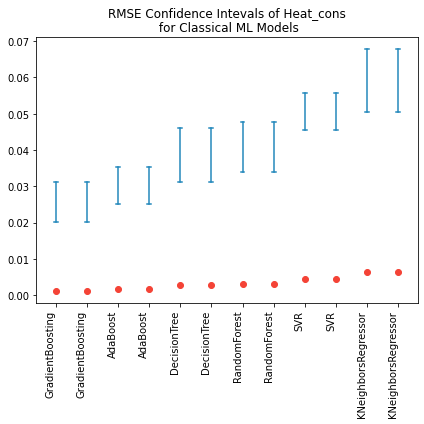

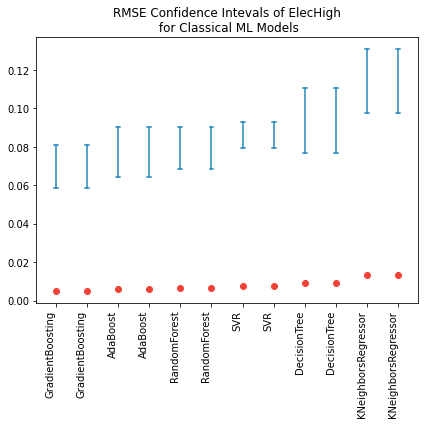

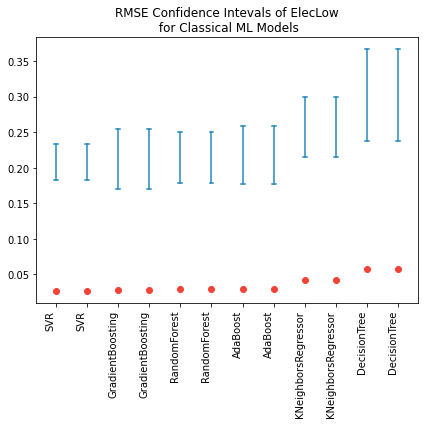

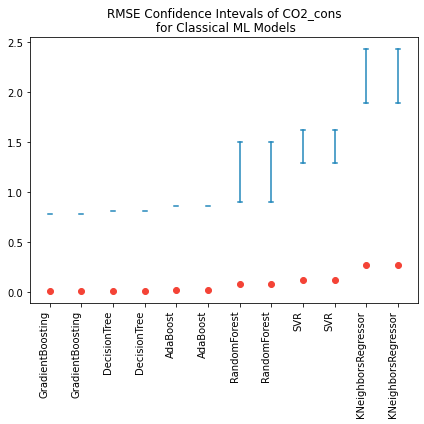

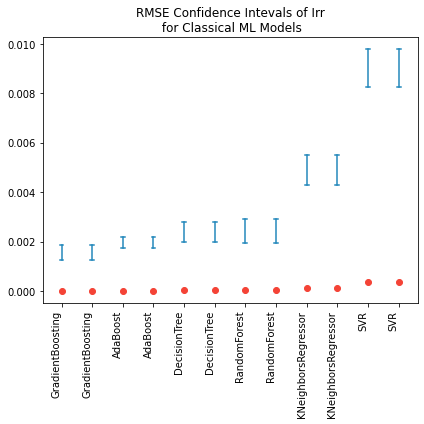

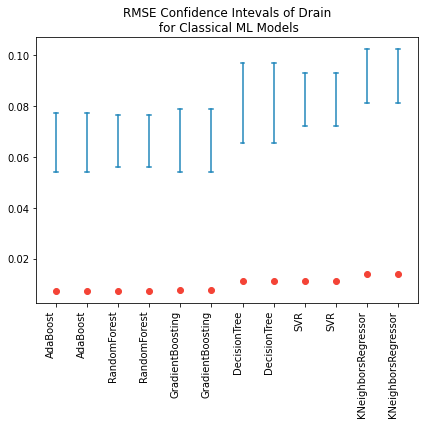

In [155]:
for out in outputs:
    plt.figure(figsize=(6,6))
    plt.xticks(range(len(conf_interv_result[out])),list(conf_interv_result[out]['Model']),
                rotation = 90, ha="right")
    plt.title(f'RMSE Confidence Intevals of {out}\n for Classical ML Models',fontsize=12)
    for C1,C2,b in zip(conf_interv_result[out]['C1'],conf_interv_result[out]['C2'],
                        range(len(conf_interv_result[out]))):
        color='#2187bb'
        horizontal_line_width=0.25
        left = b - horizontal_line_width / 4
        right = b + horizontal_line_width / 4
        #plt.plot((b,b),(C1,C2),'ro-',color='orange')
        plt.plot([b, b], [C2, C1], color=color)
        plt.plot([left, right], [C2, C2], color=color)
        plt.plot([left, right], [C1, C1], color=color)
        plt.plot(b, conf_interv_result[out]['RMSE'][b], 'o', color='#f44336')
    save_fig(f'RMSE_Confidence_Intevals_{out}_ML_Models')

    #plt.xticks(range(len(confidence_interval_results)),list(confidence_interval_results['Model']))
    plt.show()

In [156]:
#for pred_out,i in zip(outputs,range(len(outputs))):
#    plt.style.use("ggplot")
#    plt.figure()
#    plt.plot(test_prediction[:,i][15:50],label='predected', marker=".")
#    plt.plot(testY[pred_out].values[15:50],label='Actual',marker=".")
#
#    plt.title(f"Predicted Vs. Actual of {pred_out} \nsamples of {Chain Regressorgressor}",fontsize=12)
#    plt.xlabel("samples")
#    plt.ylabel(f"{pred_out}")
#    plt.legend(loc="lower left")
#    save_fig(f"Predicted Vs. Actual of {pred_out} in discrete time series points of Chain Regressor")
#
#    plt.show()

In [157]:
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV,RandomizedSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.compose import TransformedTargetRegressor
from sklearn.metrics import mean_squared_error,r2_score
from scipy.stats import randint
from sklearn.multioutput import RegressorChain



outputs=teams_drc.columns
train_results=dict()
train_results[outputs[0]]=[] 
train_results[outputs[1]]=[]
train_results[outputs[2]]=[]
train_results[outputs[3]]=[]
train_results[outputs[4]]=[]
train_results[outputs[5]]=[]
test_results=dict()
test_results[outputs[0]]=[] 
test_results[outputs[1]]=[]
test_results[outputs[2]]=[]
test_results[outputs[3]]=[]
test_results[outputs[4]]=[]
test_results[outputs[5]]=[]

conf_interv_results=dict()
conf_interv_results[outputs[0]]=[]
conf_interv_results[outputs[1]]=[]
conf_interv_results[outputs[2]]=[]
conf_interv_results[outputs[3]]=[]
conf_interv_results[outputs[4]]=[]
conf_interv_results[outputs[5]]=[]

train_rmse=dict()
train_r2=dict()
train_mse=dict()
test_rmse=dict()
test_r2=dict()
test_mse=dict()
c1=dict()
c2=dict()
from sklearn.multioutput import MultiOutputRegressor
from sklearn.multioutput import RegressorChain



estimator=RandomForestRegressor(n_estimators= 100,criterion='squared_error',
    max_depth= None,min_samples_split= 2,min_samples_leaf= 1,min_weight_fraction_leaf= 0,max_features='sqrt',
    max_leaf_nodes= None,min_impurity_decrease= 0,bootstrap= True,oob_score=False,n_jobs= -1,
    ccp_alpha=0,max_samples= None,random_state=42)

best_models=dict()

best_models['Chain_Regressor']=RegressorChain(base_estimator=estimator,order=[0,1,2,3,4,5],random_state=42)
full_pipeline = Pipeline([
    ('preprocessing', preprocessing),
    ('Chain_Regressor',best_models['Chain_Regressor'] )
                        ])
       
param_grid=[{ 
                'Chain_Regressor__base_estimator__max_depth':[2,6,None,8],
                'Chain_Regressor__base_estimator__n_estimators':[100,120,150,200,300,500],
                'Chain_Regressor__base_estimator__criterion':['squared_error','friedman_mse'],
                'Chain_Regressor__base_estimator__min_samples_split':[2,10,8],
                'Chain_Regressor__base_estimator__max_samples':[None,100,20,80],
                'Chain_Regressor__base_estimator__max_features':['sqrt','log2'],
                'Chain_Regressor__base_estimator__ccp_alpha':[0,.1,.01,10,1],              
            }]
grid_search=GridSearchCV(full_pipeline,param_grid,cv=10,scoring='neg_root_mean_squared_error',verbose=2)


In [158]:
#grid_search.fit(trainX,trainY)


In [159]:
#train_prediction=cross_val_predict(grid_search.best_estimator_,trainX,trainY,cv=3)
#test_prediction=cross_val_predict(grid_search.best_estimator_,testX,testY,cv=3)


In [160]:


#for i,out in zip(range(0,len(labels.columns),1),labels.columns):
#    #train scores:
#    train_rmse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=trainY[out])/labels[out].mean()
#    train_mse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=trainY[out])/labels[out].mean()
#    train_r2[out]=r2_score(y_true=trainY[out],y_pred=train_prediction[:,i])
#    #train result for each output
#    train_results[out].append(('Chain_Regressor',train_rmse[out],train_mse[out],train_r2[out]))
#   
#    #test scores:
#    test_rmse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=testY[out])/labels[out].mean()
#    test_mse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=testY[out])/labels[out].mean()
#    test_r2[out]=r2_score(y_true=testY[out],y_pred=test_prediction[:,i])
#    #test result for each output
#    test_results[out].append(('Chain_Regressor',test_rmse[out],test_mse[out],test_r2[out]))
#    
#    # Plot predicted vs actual
#    plt.style.use("ggplot")
#    plt.scatter(testY[out], test_prediction[:,i],color='steelblue')
#    plt.xlabel(f'Actual {out}')
#    plt.ylabel(f'Predicted {out}')
#    plt.title(f'predicted vs actual {out} \nplot for Chain Regressor',fontsize=12)
#    # overlay the regression line
#    z = np.polyfit(testY[out], test_prediction[:,i], 1)
#    p = np.poly1d(z)
#    plt.plot(testY[out],p(testY[out]),color='red')
#    #plt.grid()
#    save_fig(f'predicted vs actual {out} plot for Chain Regressor')
#    plt.show()
#
#
#
#    from scipy import stats
#    #confidence_interval:
#    confidence = 0.95
#    squared_errors = (test_prediction[:,i] - testY[out]) ** 2
#    zscore = stats.norm.ppf((1 + confidence) / 2)
#    zmargin = zscore * squared_errors.std(ddof=1) / np.sqrt(len(squared_errors))
#    c1[out] = np.sqrt(squared_errors.mean() - zmargin)/labels[out].mean()
#    c2[out] = np.sqrt(squared_errors.mean() + zmargin)/labels[out].mean()
#    #confidence_intervals for each output:
#    conf_interv_results[out].append(('Chain_Regressor',test_rmse[out],c1[out],c2[out],c2[out]-c1[out]))
#    
#print(train_results[outputs[0]],'\n',train_results[outputs[1]],'\n',train_results[outputs[2]],'\n',
#      train_results[outputs[3]],'\n',train_results[outputs[4]],'\n',train_results[outputs[5]],'\n')
#print(test_results[outputs[0]],'\n',test_results[outputs[1]],'\n',test_results[outputs[2]],'\n',
#      test_results[outputs[3]],'\n',test_results[outputs[4]],'\n',test_results[outputs[5]],'\n')
#print(conf_interv_results[outputs[0]],'\n',conf_interv_results[outputs[1]],'\n',conf_interv_results[outputs[2]],'\n',
#      conf_interv_results[outputs[3]],'\n',conf_interv_results[outputs[4]],'\n',conf_interv_results[outputs[5]],'\n')
#

In [161]:
#for pred_out,i in zip(outputs,range(len(outputs))):
#    plt.style.use("ggplot")
#    plt.figure()
#    plt.plot(test_prediction[:,i][15:50],label='predected', marker=".")
#    plt.plot(testY[pred_out].values[15:50],label='Actual',marker=".")
#
#    plt.title(f"Predicted Vs. Actual of {pred_out} \nsamples of Chain Regressor",fontsize=12)
#    plt.xlabel("samples")
#    plt.ylabel(f"{pred_out}")
#    plt.legend(loc="lower left")
#    save_fig(f"Predicted Vs. Actual of {pred_out} in discrete time series points of Chain Regressor")
#
#    plt.show()

In [162]:
#best_params=grid_search.best_params_
##best_params['RandomForestRegressor__base_estimator']=grid_search.best_estimator_['RandomForestRegressor__base_estimator'].n_estimators_
#GBR_best_param=pd.DataFrame.from_dict(grid_search.best_params_,orient='index',columns=['best value'])
#GBR_best_param['best value']

In [163]:
##show training results table:
#best_trained_model_idx=dict()
#test_result=dict()
#
#for out in outputs:
#    print(f'best models train {out} scores:',test_results[out])
#    best_trained_model_idx[out]=np.array(test_results[out])[:,1].argmin()
#
#
#    #print('best models test scores:',test_results)
#    #best_tested_model_idx=np.array(test_results)[:,1].argmax()
#
#    print('best trained model:',test_results[out][best_trained_model_idx[out]][0],
#                            test_results[out][best_trained_model_idx[out]][1],'\n')
#
#
#    #print('best tested model:',test_results[best_tested_model_idx][0],test_results[best_tested_model_idx][1])
#    test_result[out]=pd.DataFrame(test_results[out],
#               columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')
#
#    #dfi.export(test_result, "ModelsTrainingResultsTable.png")
#    print(test_result[out])
#

In [164]:
#print(outputs[0],'\n')
#test_result[outputs[0]]

In [165]:
#print(outputs[1],'\n')
#test_result[outputs[1]]

In [166]:
#print(outputs[2],'\n')
#test_result[outputs[2]]

In [167]:
#print(outputs[3],'\n')
#test_result[outputs[3]]

In [168]:
#print(outputs[4],'\n')
#test_result[outputs[4]]

In [169]:
#print(outputs[5],'\n')
#test_result[outputs[5]]

In [170]:
##grid_search.best_estimator_.save('DailyResourceConsumptionEstimator.pkl')
#
#import joblib
#
#joblib.dump(grid_search.best_estimator_,'DailyResourceConsumptionEstimator.pkl')
#
#loaded_model=joblib.load('DailyResourceConsumptionEstimator.pkl')
#
#new_data=testX
#predictions=loaded_model.predict(new_data)
#print(predictions,testY)
#

In [171]:
import joblib
#joblib.dump(models['GradientBoosting'],'GradientBoostingDailyResourceConsumptionEstimator.pkl')


loaded_model=joblib.load('GradientBoostingDailyResourceConsumptionEstimator.pkl')

new_data=testX
predictions=loaded_model.predict(new_data)
print(predictions,testY)

[[ 1.47299022e-01  5.29684457e-01  4.44375565e-01  7.73835379e-02
   3.02436673e-03  2.63105014e-03]
 [ 1.04068969e-01  1.91603583e-01  2.58684630e-01  7.15522420e-01
   1.07197923e-01  5.70588361e-01]
 [ 4.41203903e-01  1.59106588e-01  6.21236083e-01  4.63082675e-01
   6.82314941e-02  2.29930331e-01]
 ...
 [ 2.26696975e-01  7.94808550e-01  7.56957210e-01  4.70663823e-01
   5.29364303e-02  1.59662810e-01]
 [ 1.93393436e-01  2.49125689e-03  3.61485328e-01  7.67214059e-01
   7.48032078e-02  2.10003263e-01]
 [ 8.42701714e-02  5.54588809e-03 -2.19548354e-04  3.96762912e-01
   3.67957761e-02  2.78434137e-02]]      Heat_cons  ElecHigh   ElecLow  CO2_cons       Irr     Drain
0     0.162752  0.451162  0.611888  0.076785  0.000000  0.000000
1     0.097315  0.135349  0.349650  0.722018  0.119599  0.626841
2     0.437265  0.145161  0.687500  0.463214  0.063122  0.261866
3     0.318020  0.674938  0.713287  0.349767  0.091603  0.256956
4     0.120050  0.397849  0.625000  0.598101  0.146897  0.56301